# GG4257 - Urban Analytics: A Toolkit for Sustainable Urban Development
## Lab Workbook No 3: Geovisualization Techniques - Data Viz.
---
Dr Fernando Benitez -  University of St Andrews - School of Geography and Sustainable Development - Iteration 2024

# Objectives

By the end of this practical lab, you will be able to:

* Create summary descriptive statistics for numeric attributes
* Generate frequency tables
* Use aggregation functions
* Write a basic user function
* Convert between co-ordinate reference systems
* Create contextual statistics for geographic features using buffers
* Handle and Map big data sets using additional libraries and frameworks



> **GOOD ACADEMIC PRACTICE**: As always, The University policy on Good Academic Practice applies. There are probably many ways to address the challenges in here or part of them. You are free to do research and find relevant resources, like the documentation website, if you cited them correctly. But I strongly advise not to use AI tools, most importantly because you won't learn/practice as you are supposed to.
>
> If you still insist on using AI tools, you must cite any code or work you are taking/adapting from it. However, if cited correctly, your mark will be lower, and if not cited correctly, you risk incurring academic misconduct.
>
>  If you are not aware of **our academic misconduct policy**, kindly take a quick look (Pag 8. https://www.st-ndrews.ac.uk/policy/academic-policies-assessment-examination-and-award-good-academic-practice/good-academic-practice-guidance-for-students-frequently-asked-questions.pdf)


In [ ]:
# Notes from Week 3 Lecture 
#Understanding data and cleaning data 
# Types of variable descriptions: 
#df.head()
#df.info()
#df.columns()
#df.describe()
# This gives you summary statistics 
#df.variable.unique()
# This will give you summary statistics for only one variable or column 

In [ ]:
# Missing values
# df.isnull().sum() --> therefore, combining isnull with sum, you can sum up all the missing values for each variables 
# Duplicated values: df.drop_duplicates(keep = 'first', inplace = True) 
# Try to make a copy (copy_df = df.drop_duplicates....
# First is used to keep the first row of duplicated values
# True is used to make it permanent - if it was not there, then the original df would stay the same 

In [ ]:
# Data Visualisation
# Univariate analysis aims to understand the dist of values for a single variables
# Univariate analysis can be done in 3 ways: summary stats, frequency dist table, charts
# Charts: sns.distplot(), sns.boxplot()

# Bivariate Analysis 
# Relationships between two variables (see scatterplot, boxplots) 
# Pairplot is a method that shows the relationships between two numerical values as well as the distribution of each variable (sns.pairplot)

In [ ]:
# Multivariate analysis 
# combining .corr with .heatmap 

In [ ]:
# Geo Vizualisation (geoviz) 
# Folium: visualising data to create an interactive map 

In [ ]:
# Lonboard 
# Data visualisation in jupyter with geoarrow, geoparquet with GPU based map rendering 
# Datashader --> change the format of the data in order to process large datasets, by rasterizing the data 
# Datashader is a graphics pipeline system for creating representations of large datasets 

In [ ]:
"""
Week 4: Urbvan Viz II and Apps 
Uses of UA: data driven decision making, improved efficiency anbd sustainability, engagement of citizens through apps 
Workflow: 
Data, pre-processing, analysis process, define the problem, then create the tools, maps, and interactions to design the apps
Last part: take all these outcomes and then represent it in an interactive application 
Traffic mgmt (mobility mapping) 
public safety (crime, emergency response) 
environmental monitoring (air qual, water qual, energy) 
resrouce mgmt (trash, water dist, energy) 
economic development (economic trends, local entrepreneurs) 
citizen or academic engagement (access to data, facilitate feedback) 

How to build apps: 
Front end: Develop the interface or dashboard to represent what happens in the backend 
- Languages like HTML, CSS, and JavaScript. Frameworks like React, Angular, Vue,js 
Back end: All the software needed to manage the data 
- Python, Java, or Node.js Frameworks like Django, Spring, or Express.js 
Databases: Relational databases like MYSQL or PostgreSQL 
- Move to MongoDB or Cassandra 
- Ways to query these 
Visualisation tools: Bokeh, Plotly, D3.js 
Mapping: Leaflet, ArcGIS, etc. 

Deployment: 
Cloud hosting - requires internet, scalable, cost effective, training in the cloud platform 
On premise hosting - offers more control but also dedicated hardware and IT expertise 
hybrid approach - combines both 

Skill in Internet of things - learn how to do this - where to start? ask benitez : arduino IDE, Platform IO, cloud based: AWS IoT, Azure IoT hub
tensor flow, pytorch, scikit learn 
use cases: with VR headsets, Unity, unreal engine, arkit (ios) or ARCore(android) 

"""

# Basic numeric summary statistics

In the first part of this practical, we will import some [Airbnb](http://insideairbnb.com/get-the-data.html) data for Amsterdam that was collected during July 2016. Adapted from (Singleton, 2017)
 

In [ ]:
import os 
os.getcwd ()

In [ ]:
import pandas as pd

listings =pd.read_csv("data/listings.csv")

#Show column headings
listings.tail()

However, for this practical, we will subset these data to a limited set of variables; in the previous example, we used a list or Dict to define a new subset of columns; here, you have another method.

In [ ]:
# Subset data
subset_listings = listings[['id', 
                            'neighbourhood_cleansed',
                            'latitude',
                            'longitude',
                            'property_type',
                            'room_type',
                            'bedrooms',
                            'price',
                            'number_of_reviews']]

# We need to do some cleaning...There are some weird characters $ and , then convert the outcome to a dtype numeric.
# I use multiple functions in one line, but the key is using .loc and replace., check this link for more information.
# https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.loc.html
subset_listings.loc[subset_listings.index, 'price'] = subset_listings['price'].replace('[\$,]', '', regex=True).astype(float)

# Remove any records that are not complete
subset_listings = subset_listings.dropna()

# Let's see the results.
subset_listings.head()

In [ ]:
subset_listings.dtypes

The simplest way to create a set of descriptive statistics is to use the **describe()** function which returns the minimum, maximum, first and third quartile, and the mean and median for each column. For non numeric columns (e.g. neighbourhood_cleansed),the frequencies of the top seven most frequent attributes are shown.

In [ ]:
# Generate descriptive statistics
descriptive_stats = subset_listings.describe()
descriptive_stats

In [ ]:
descriptive_stats_non_numerical = subset_listings.describe(exclude='number')
descriptive_stats_non_numerical

# Frequency tables

Another common fundamental analysis task is to create a frequency table for a categorical variable - for example, the number of listings per neighbourhood. This can be achieved using the value_counts() function, which prints a list of the unique attributes and the frequency of these observations.


In [ ]:
neighborhood_counts = subset_listings['neighbourhood_cleansed'].value_counts()
neighborhood_counts

It is also possible to create cross-tabulations; showing the frequency of two attributes - here we look at neighborhood and bedrooms:

In [ ]:
# Here for the complete doc https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.crosstab.html 
cross_tabulation = pd.crosstab(subset_listings['neighbourhood_cleansed'], subset_listings['bedrooms'])
cross_tabulation

In [ ]:
cross_tabulation.info()

# Create aggregations and summary statistics

I have shown how you can use various descriptive summary functions for single columns, however, it is also possible to combine these with other functions which make these calculations within aggregations. This is especially useful for geographic application where you can create summaries by a defined area. In the following example I will use the function groupby() to find out what the mean price is by neighborhood:


In [ ]:
Sum_by_area = subset_listings.groupby('neighbourhood_cleansed')['price'].mean().reset_index()
Sum_by_area

>The `reset_index()` function in pandas is used to reset the index of a DataFrame. In Pandas when you apply the `group_by()` the resulting DataFrame often has a hierarchical index based on the grouping columns, making it a MultiIndex DataFrame., usually that is an issue.

In our analysis, we have so far only examined the average price. However, if we want to generate several different statistics for each aggregation, we can do so by creating a custom function. Throughout the labs, we have used various functions, some of which are built into the base version of Python, while others are available through libraries that we have loaded.

In this example, we create a new function called `data_description`, which calculates a mean and counts the number of records - these are stored within a new object called "stats", which is returned when the function is run.

In [ ]:
# data_description function
def data_description(x):
    stats = {'M': x.mean(), 'S': len(x)}
    return stats

In [ ]:
result = data_description(subset_listings.price)
print(result)

# Challenge 1

**What happens if you have non-numerical attributes?**

Please extend the `data_description` function to only accept numerical columns and calculate mean and counts. The outcome should be a table with Mean and Counts per Column.

> Tip: Check this function in pandas to filter the numerical values. https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.select_dtypes.html#pandas.DataFrame.select_dtypes
> Here some extra resources of creating function in python https://www.geeksforgeeks.org/python-functions/?ref=lbp


In [ ]:
"""
 Challenge 1. You need to use conditional and Loops to run over the subset_listings dataframe, define which columns
 are no-numerical, and then calculate the mean and counts only for those. In the example, we did it only for the column price., 
 Your task is to create another dataframe that includes the mean and counts for all the no-numerical columns. 
 Use the suggested functions. 
"""

In [ ]:
subset_listings.dtypes

In [ ]:
def data_description(x):
    # # From the pandas documentation, I can use .select_dtypes to filter only numeric columns by excluding the object dtype. I could also do this using include=['number']
    numeric_columns = x.select_dtypes(exclude=['object'])
    # Now, I can specify in the stats line to calculate the mean 
    # .count I found from here: https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.count.html
    stats = {'M': numeric_columns.mean(), 'C': numeric_columns.count()}
    return stats

result = data_description(subset_listings)
print (result)

# Spatial summary measures

So far we have considered a pre-defined geography in the previous example: neighborhoods. However, a common spatial analysis task is to create descriptive statistics related to the context of features. This task will typically require a buffer to be created around a feature and then data aggregated and summarized within the buffers.

First we will import a spatial data file that relates to [historic building locations](http://maps.amsterdam.nl/open_geodata/):


In [ ]:
import geopandas as gpd

# Recall here how to read external files in geopandas. https://geopandas.org/en/stable/docs/user_guide/io.html
historic_buildings = gpd.read_file("data/historic_buildings.geojson")

historic_buildings.head()

Here is why I love python and GeoPandas, as the external file is GeoJSON including the geometry attribute, the result is already a spatial dataframe. That will be different in R where you need to locate the rows. 

In [ ]:
historic_buildings

In [ ]:
# We need to create a GeoDataFrame from the subset_listings
geometry = gpd.points_from_xy(subset_listings['longitude'], subset_listings['latitude'])
geo_listings = gpd.GeoDataFrame(subset_listings, geometry=geometry, crs=historic_buildings.crs)
geo_listings.explore()

In [ ]:
print(historic_buildings.crs)
print(geo_listings.crs)

Before making any spatial analysis we need to project the data

In [ ]:
projected_historic_buildings = historic_buildings.to_crs('EPSG:28992')
projected_geo_listings = geo_listings.to_crs('EPSG:28992')
print(projected_historic_buildings.crs)
print(projected_geo_listings.crs)

Now, lets make a buffer of 200m from all the historic buildings.

In [ ]:
historic_buffers = projected_historic_buildings.buffer(200)
historic_buffers.info()

This outcome does not have an ID, so we can easily create one. Also, the outcome is a GeoSeries which cannot be used in a buffer analysis. You can transform it using the geometry values.

In [ ]:
historic_buffers_gdf = gpd.GeoDataFrame(geometry=historic_buffers)

In [ ]:
# Setting the crs
historic_buffers_gdf.crs = 'EPSG:28992'

historic_buffers_gdf['buffer_id'] = range(len(historic_buffers_gdf)) # Creating an id for an outcome 
historic_buffers_gdf.explore()

Running the spatial join to get the number of listings and their attributes per buffer area. More info here: https://geopandas.org/en/stable/docs/user_guide/mergingdata.html

In [ ]:
spatial_result =  projected_geo_listings.sjoin(historic_buffers_gdf, how="inner", predicate='intersects')
spatial_result.head()

To make things easier we can filter the buffer with more listings.

In [ ]:
listings_per_buffer = spatial_result.groupby('buffer_id').size().reset_index(name='listings_per_buffer')
listings_per_buffer

And now we can pick one of the buffer areas. For instance the 194.

In [ ]:
filtered_row = spatial_result[spatial_result['buffer_id'] == 194]
filtered_row.explore()

With this process now you can explore the prices, age, and other attributes related to the historic buldings and the AirBnb listings in Amsterdam., A useful excersice we can do is to plot for the random buffer area, plot th listings included in the areas and get the descritive estadistics. For example:

In [ ]:
historic_buffers_gdf.head()

In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(8, 8))

# We can plot the buffer areas and its listings
filtered_buffer = historic_buffers_gdf[historic_buffers_gdf['buffer_id'] == 194].plot(ax=ax, color="#D4D4D4", alpha=0.5)

# We can overlay all listings within the filtered buffer
filtered_row.plot(ax=ax, marker='o', color="#FF4500", markersize=5, alpha=0.7)

# Make the plot nicer
ax.set_title("Listings within Buffer - ID 194")
plt.show()

# Plot a histogram of the 'price' attribute
plt.figure(figsize=(6, 4))
filtered_row['price'].plot(kind='hist', bins=20, color='#FF4500', alpha=0.7)
plt.title('Distribution of Listings Prices within Buffer - ID 194')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.show()


In [ ]:
filtered_row.explore("price", cmap='Oranges', tiles='Esri_WorldGrayCanvas', zoom_start=17)
#See here all the list of Basemap ( tiles) options: https://leaflet-extras.github.io/leaflet-providers/preview/

# Folium 

Folium is a helpful library that facilitates the creation of interactive maps in Python. It allows you to visualize data on an interactive leaflet map, which can be easily manipulated. With Folium, you can bind data to a map for choropleth visualizations, and pass rich vector, raster and HTML visualizations as markers on the map. You can learn more about this library by visiting https://python-visualization.github.io/folium/latest/.




In [ ]:
import folium
from folium import plugins
from folium.plugins import MeasureControl
from branca.colormap import linear
from branca import colormap
from branca import colormap as cm

In [ ]:
lon, lat = -38.625, -12.875

zoom_start = 8

folium.Map(location=[lat, lon], tiles="OpenStreetMap", zoom_start=zoom_start)

In [ ]:
folium.Map(location=[lat, lon], tiles="Cartodb Positron", zoom_start=zoom_start)


In [ ]:
folium.Map(location=[lat, lon], tiles="Cartodb dark_matter", zoom_start=zoom_start)

https://leaflet-extras.github.io/leaflet-providers/preview/ Here you can get the list of all the supported tiles

In [ ]:
filtered_row.head()

In [ ]:
m = folium.Map([52.368152,4.897582], zoom_start=10)
location=filtered_row[["latitude","longitude"]]

plugins.MarkerCluster(location).add_to(m)
m

# Clic the cluster.

In [ ]:
folium.plugins.HeatMap(filtered_row[["latitude","longitude"]]).add_to(m)
m

# Challenge 2

Now is your turn to find, read, process and then make a comprehensive descriptive statistics analysis based on the previous resources and others you might need to look at. Create insightful visualizations combining both maps and charts to convey meaningful information about a chosen city.

1. Define a problem within the urban environment and choose a dataset related to urban life or city dynamics. This could include data on crime rates, housing prices, transportation, demographics, or any other urban-related dataset.
2. Get the data ideally using an **API, or web services**. But it's fine if you need to download the data. Describe why you had to use the traditional  method.
3. Work with the data cleaning and pre-processing, check for missing values, convert data types, and perform any other necessary preprocessing steps. You have the code for that in this and previous labs.
4. Use Pandas to calculate descriptive statistics such as `mean`, `median`, `standard deviation`, and other relevant measures. Explore `correlations` between different variables (Include at least one `univariate` and `bivariate` plots) 
6. Create at least one (or more) interactive map to visualize spatial aspects of the data. For example, plot crime rates across different neighbourhoods or visualize housing prices.
7. Complement with additional charts (line charts, bar charts, etc.) to extend the map and highlight key trends or patterns in the data.
8. As always, document well what you are doing and how you use `descriptive statistics and map visualizations` to extract insights from the data.
> You could try explaining any observed patterns, trends, or correlations, whether they are spatial or non-spatial. **Keep in mind** the defined problem and whether your analysis provides the required insights (Your conclusion could be that you need more data or another type of analysis)

## 1. Defining a problem: Crime Rates and Transportation Hubs in Washington D.C. 
Washington D.C. has the [highest crime rate per 100,000 people](https://www.statista.com/statistics/200445/reported-violent-crime-rate-in-the-us-states/#:~:text=Reported%20violent%20crime%20rate%20in%20the%20U.S.%202022%2C%20by%20state&text=In%202022%2C%20the%20District%20of,per%20100%2C000%20of%20the%20population.) in the United States. While this largely came to national attention in the 1980s and the 1990s, it still is quite high. 

Additionally, many people in the city are reliant on transportation (particularly the underground train, or the Metro) to commute to work. Other studies have linked crime rates to transportation hubs, as linked below. 
1. [The spatial relationship between crime and public transportation: A geospatial analysis of Salt Lake City's TRAX system](https://www.proquest.com/docview/1658559488?pq-origsite=gscholar&fromopenview=true&sourcetype=Dissertations%20&%20Theses)
2. [Crime and Public Transportation: A Case Study of Ottawa’s O-Train System](https://www.utpjournals.press/doi/abs/10.3138/cjccj.2016.E35)

Irvin-Erikson and La Vigne, in a [spatio-temporal analysis of crime around Washington's metro stations](https://crimesciencejournal.biomedcentral.com/articles/10.1186/s40163-015-0026-5), found that crimes at stations are affected by the immediate and larger environment in which the station is housed in. Different crimes are more likely to happen at stations with certain characteristics, such as parking availability and remoteness at particular times.

Therefore, further exploring the relationship between transportation hubs and crime rates would provide insights into how crime is spatially distributed, particularly in a place like DC that has seen rapid gentrification and an influx of white, upper-middle class workers into the city for government and related work. Therefore, this analysis will focus on the relationship between crime incidents in 2022 near Metro Stations in DC. It will determine the correlation between size of the station and the number of crimes reported within a certain buffer distance. 

## 2. Getting the data
The city of Washington D.C. publishes APIs and data here: https://opendata.dc.gov/. However, using an API requires an authenticated app token, which I do not have access to and could only access the first 1000 rows of data even though there were 27,000 total rows of data. Therefore, I had to download the data into a csv. file to access this. 
Even so, I've included both processes below; the first is reading the data from an API (and then transforming into a pd), and the second is from the downloaded data in csv form. 

### 2.1 From an API

In [ ]:
import requests
import pandas as pd
import geopandas as gpd

# Describing the url for the Crime Incidents in 2022 dataset
url_crime = "https://maps2.dcgis.dc.gov/dcgis/rest/services/FEEDS/MPD/MapServer/4/query?where=1%3D1&outFields=SHIFT,OFFENSE,WARD,LATITUDE,LONGITUDE&outSR=4326&f=json"
# Making the query to the web server, using the Get method from the requests library 
response = requests.get(url_crime)
response

In [ ]:
data = response.json()
data # I put this into my browser's json viewer. Data is under the features list and then also under properties. 

In [ ]:
# Similar to the metadata /data structure, the data here that I need is under features, and then its under attributes. 
crime_data = data['features']
crime_data # Now, I just need to call properties to then access the lat, long, offense, shift, and ward. 

In [ ]:
# Based on the same process of creating loops to iterate over each list in Challenge No. 2, we can change the structure of the data. 

In [ ]:
# Firstly, I need to create empty columns to store the data under the from column
SHIFT_list = []
OFFENSE_list = []
WARD_list = []
lat_list = []
long_list =[]

In [ ]:
# Now, I need to create a 'for' loop to go over each of the entries in the json array 
for index in crime_data: # Defining where I want to entries to come from 
    OFFENSE = index['attributes']['OFFENSE'] 
    WARD = index['attributes']['WARD'] 
    SHIFT = index['attributes']['SHIFT']
    lat = index['attributes']['LATITUDE']
    long = index['attributes']['LONGITUDE']

# Now, I need to add these values to the empty lists I created earlier
    SHIFT_list.append(SHIFT)
    OFFENSE_list.append(OFFENSE)
    WARD_list.append(WARD)
    lat_list.append(lat)
    long_list.append(long)

# So at this point, my values are added to the empty lists. Therefore, I am ready to create a dataframe. 
crime_pd_from_json = pd.DataFrame({ # I have to define the values to go in each column
    'SHIFT': SHIFT_list,
    'OFFENSE': OFFENSE_list,
    'WARD': WARD_list,
    'lat': lat_list,
    'long': long_list,
})

In [ ]:
crime_pd_from_json.info() # As u can see, there are only 1000 entries. Therefore, I had to download the data into a csv and load it the traditional way. 
# I've copied the csv and placed it in my github repo, but you can also download it here: https://opendata.dc.gov/datasets/DCGIS::crime-incidents-in-2022/about

### 2.2 Downloading the Data 

In [51]:
# Here's the traditional CSV method. 
crime_pd = pd.read_csv("data/Crime_Incidents_in_2022.csv")

In [52]:
crime_pd.info() # As you can see, there are over 27000 entries. 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27158 entries, 0 to 27157
Data columns (total 25 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   X                     27158 non-null  float64
 1   Y                     27158 non-null  float64
 2   CCN                   27158 non-null  int64  
 3   REPORT_DAT            27158 non-null  object 
 4   SHIFT                 27158 non-null  object 
 5   METHOD                27158 non-null  object 
 6   OFFENSE               27158 non-null  object 
 7   BLOCK                 27158 non-null  object 
 8   XBLOCK                27158 non-null  float64
 9   YBLOCK                27158 non-null  float64
 10  WARD                  27153 non-null  float64
 11  ANC                   27157 non-null  object 
 12  DISTRICT              27133 non-null  float64
 13  PSA                   27127 non-null  float64
 14  NEIGHBORHOOD_CLUSTER  27157 non-null  object 
 15  BLOCK_GROUP        

In [53]:
crime_pd.head()

,X,Y,CCN,REPORT_DAT,SHIFT,METHOD,OFFENSE,BLOCK,XBLOCK,YBLOCK,...,BLOCK_GROUP,CENSUS_TRACT,VOTING_PRECINCT,LATITUDE,LONGITUDE,BID,START_DATE,END_DATE,OBJECTID,OCTO_RECORD_ID
0,-76.952778,38.890221,13160143,2022/03/01 05:00:00+00,MIDNIGHT,GUN,HOMICIDE,3652 - 3701 BLOCK OF MINNESOTA AVENUE NE,404097.0,135820.0,...,009603 3,9603.0,Precinct 102,38.890214,-76.952775,NaN,2013/11/06 18:07:00+00,2013/11/06 18:07:00+00,471874610,NaN
1,-76.966830,38.937844,8007762,2022/06/20 17:20:04+00,DAY,OTHERS,MOTOR VEHICLE THEFT,BUNKER HILL ROAD NE AND RANDOLPH STREET NE,402876.0,141106.0,...,009400 1,9400.0,Precinct 69,38.937837,-76.966827,NaN,2022/06/20 04:00:00+00,NaN,471874611,NaN
2,-77.022438,38.907237,18042623,2022/01/01 05:00:00+00,MIDNIGHT,KNIFE,HOMICIDE,700 - 799 BLOCK OF N STREET NW,398054.0,137708.0,...,004902 2,4902.0,Precinct 129,38.907229,-77.022436,DOWNTOWN,2018/03/16 15:51:08+00,NaN,471890451,NaN
3,-77.024177,38.935504,22117652,2022/08/16 15:21:50+00,DAY,OTHERS,THEFT/OTHER,3639 - 3649 BLOCK OF GEORGIA AVENUE NW,397904.0,140846.0,...,003100 2,3100.0,Precinct 43,38.935497,-77.024175,NaN,2022/08/16 13:45:00+00,2022/08/16 14:15:00+00,471899883,NaN
4,-76.990895,38.900203,22118176,2022/08/17 14:00:18+00,DAY,OTHERS,THEFT/OTHER,1100 - 1199 BLOCK OF H STREET NE,400790.0,136927.0,...,008402 1,8402.0,Precinct 82,38.900195,-76.990893,NaN,2022/08/17 13:27:00+00,2022/08/17 13:59:00+00,471899884,NaN


In [54]:
# I can use keep_cols to define the columns that are necessary. For these purposes, this is x, y, ward, offense, and shift 
keep_cols = [
    "WARD",
    "SHIFT",
    "OFFENSE",
    "X",
    "Y",
]
crime_pd = crime_pd[keep_cols]
crime_pd.head()

,WARD,SHIFT,OFFENSE,X,Y
0,7.0,MIDNIGHT,HOMICIDE,-76.952778,38.890221
1,5.0,DAY,MOTOR VEHICLE THEFT,-76.966830,38.937844
2,2.0,MIDNIGHT,HOMICIDE,-77.022438,38.907237
3,1.0,DAY,THEFT/OTHER,-77.024177,38.935504
4,6.0,DAY,THEFT/OTHER,-76.990895,38.900203


## 3 Data Cleaning and Pre-Processing 

In [55]:
crime_pd.dtypes # Checking the data types 

WARD       float64
SHIFT       object
OFFENSE     object
X          float64
Y          float64
dtype: object

In [56]:
# the lat and long correctly are floats. However, the WARD should be a categorical variable, so I need to convert this to a string. 
#crime_pd.WARD = crime_pd.WARD.astype(str)# I'm getting an error here. 

In [57]:
crime_pd.head()

,WARD,SHIFT,OFFENSE,X,Y
0,7.0,MIDNIGHT,HOMICIDE,-76.952778,38.890221
1,5.0,DAY,MOTOR VEHICLE THEFT,-76.966830,38.937844
2,2.0,MIDNIGHT,HOMICIDE,-77.022438,38.907237
3,1.0,DAY,THEFT/OTHER,-77.024177,38.935504
4,6.0,DAY,THEFT/OTHER,-76.990895,38.900203


### 3.1. Transforming into a GDF

In [59]:
import geopandas as gpd
crime_gdf = gpd.GeoDataFrame(crime_pd, geometry=gpd.points_from_xy(crime_pd['X'], crime_pd['Y']), crs='EPSG:4326') # Crucial to set the crs here. 
crime_gdf = crime_gdf.drop('X', axis=1)
crime_gdf = crime_gdf.drop('Y', axis=1)# We should also drop the now unnecessary lat/long columns 
crime_gdf.info()

crime_gdf.head()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 27158 entries, 0 to 27157
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   WARD      27153 non-null  float64 
 1   SHIFT     27158 non-null  object  
 2   OFFENSE   27158 non-null  object  
 3   geometry  27158 non-null  geometry
dtypes: float64(1), geometry(1), object(2)
memory usage: 848.8+ KB


,WARD,SHIFT,OFFENSE,geometry
0,7.0,MIDNIGHT,HOMICIDE,POINT (-76.95278 38.89022)
1,5.0,DAY,MOTOR VEHICLE THEFT,POINT (-76.96683 38.93784)
2,2.0,MIDNIGHT,HOMICIDE,POINT (-77.02244 38.90724)
3,1.0,DAY,THEFT/OTHER,POINT (-77.02418 38.93550)
4,6.0,DAY,THEFT/OTHER,POINT (-76.99089 38.90020)


In [60]:
print(crime_gdf.crs) # Double-checking that the crs is set. 

EPSG:4326


### 3.2 Checking for missing values 

In [61]:
# The line below will return if there are any NaN values. 
nan_in_columns = crime_gdf.isna().any()
print(nan_in_columns)

WARD         True
SHIFT       False
OFFENSE     False
geometry    False
dtype: bool


In [62]:
# Seems like the ward is not recorded for 5 of these crimes. We can drop these. 
nan_in_column_ward = crime_gdf['WARD'].isna().sum()
print(nan_in_column_ward)

5


In [63]:
crime_gdf = crime_gdf.dropna(subset=['WARD'])
nan_in_columns = crime_gdf.isna().any()
print (nan_in_columns)

WARD        False
SHIFT       False
OFFENSE     False
geometry    False
dtype: bool


### 3.3. Converting data types 

In [64]:
crime_gdf.dtypes

WARD         float64
SHIFT         object
OFFENSE       object
geometry    geometry
dtype: object

In [65]:
# the lat and long correctly are floats. However, the WARD should be a number variable, so I need to convert this to an int. 
crime_gdf.WARD = crime_gdf.WARD.astype(int)

In [66]:
crime_gdf.dtypes

WARD           int64
SHIFT         object
OFFENSE       object
geometry    geometry
dtype: object

### 3.4 Visualising the crime data

In [67]:
crime_gdf.explore()

## 4. Data Analysis for Crimes in DC
Use Pandas to calculate descriptive statistics such as `mean`, `median`, `standard deviation`, and other relevant measures. Explore `correlations` between different variables (Include at least one `univariate` and `bivariate` plots) 


Challenge 2. Use the lecture slides to get ideas about the plots you can create for the univariate and bivariate chats. 
 I expect a definition of a problem, a combination of map(s) and charts applying EDA to your data, and 
 then how you reflect on those findings. 
 Ideally, try to find APIs and WebServices when you fetch the data so you can practice libraries like requests.
Univariate Analysis 
You can perform univariate analysis with three options :
• Summary Statistics
• Frequency Distributions Table
• Charts ( Boxplot, Histogram, Barplot, Pie Chart)

sns.distplot() function. Distplot stands for
distribution plot and shows the distribution and
kernel density estimation by default.

A bar chart is commonly used to visualize categorical features.
E.g. you can use sns.countplot() 
Bivariate: 
Usually use boxplot(categorical vs numerical),
scatterplot(numerical vs numerical), or contingency
table(categorical vs categorical).
A scatterplot is a type of data display that
shows the relationship between two
numerical variables

### 4.1 Univariate Analysis
According the lectures, there are three ways to perform univariate analysis.
* Summary Statistics
* Frequency Distributions Table
* Charts ( Boxplot, Histogram, Barplot, Pie Chart )

In [68]:
crime_gdf.head()

,WARD,SHIFT,OFFENSE,geometry
0,7,MIDNIGHT,HOMICIDE,POINT (-76.95278 38.89022)
1,5,DAY,MOTOR VEHICLE THEFT,POINT (-76.96683 38.93784)
2,2,MIDNIGHT,HOMICIDE,POINT (-77.02244 38.90724)
3,1,DAY,THEFT/OTHER,POINT (-77.02418 38.93550)
4,6,DAY,THEFT/OTHER,POINT (-76.99089 38.90020)


In [69]:
crime_gdf.dtypes

WARD           int64
SHIFT         object
OFFENSE       object
geometry    geometry
dtype: object

In [70]:
# This will show us the total number of values for each offense
offense_counts = crime_gdf['OFFENSE'].value_counts()
print(offense_counts)

OFFENSE
THEFT/OTHER                   10765
THEFT F/AUTO                   7762
MOTOR VEHICLE THEFT            3738
ROBBERY                        2069
ASSAULT W/DANGEROUS WEAPON     1381
BURGLARY                       1048
HOMICIDE                        203
SEX ABUSE                       183
ARSON                             4
Name: count, dtype: int64


<Axes: ylabel='OFFENSE'>

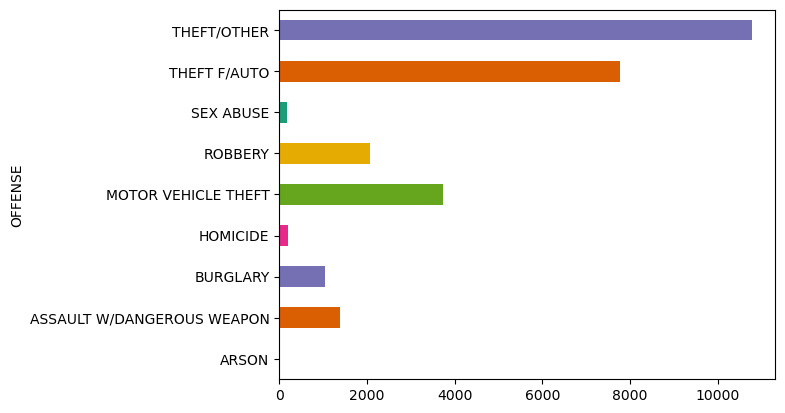

In [71]:
# We can plot this on a histogram using seaborn 
import seaborn as sns
crime_gdf.groupby('OFFENSE').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))

SHIFT
EVENING     10790
DAY         10757
MIDNIGHT     5606
Name: count, dtype: int64


<Axes: ylabel='SHIFT'>

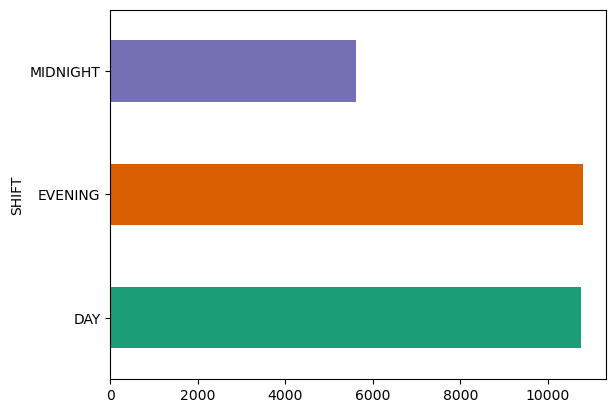

In [72]:
# About half as many arrests were made on the midnight shift. 
shift_stats = crime_gdf['SHIFT'].value_counts() #Using value counts
print(shift_stats)
crime_gdf.groupby('SHIFT').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2')) # Using a histogram

### 4.2 Bivariate Analysis
Usually means boxplot(categorical vs numerical), scatterplot(numerical vs numerical), or contingency table(categorical vs categorical).


#### Contingency Table: Cross Tabulations
The crime data provides numbers of offenses by type and by shift, as well as their location within a ward. Considering these are categorical variables, a contingency variable is sufficient. 

In [73]:
# Here for the complete documentation https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.crosstab.html 
x_tab_offense_shift = pd.crosstab(crime_gdf['OFFENSE'], crime_gdf['SHIFT'])
x_tab_offense_shift

SHIFT,DAY,EVENING,MIDNIGHT
OFFENSE,,,
ARSON,3,1,0
ASSAULT W/DANGEROUS WEAPON,269,534,578
BURGLARY,507,266,275
HOMICIDE,0,0,203
MOTOR VEHICLE THEFT,1279,1619,840
ROBBERY,415,821,833
SEX ABUSE,55,79,49
THEFT F/AUTO,3493,2977,1292
THEFT/OTHER,4736,4493,1536


In [74]:
x_tab_offense_ward = pd.crosstab(crime_gdf['OFFENSE'], crime_gdf['WARD'])
x_tab_offense_ward
# Here, we can see that ward 2 had the highest number of thefts in 2022. Ward 3, on the other hand, had the fewest. 

WARD,1,2,3,4,5,6,7,8
OFFENSE,,,,,,,,
ARSON,0,0,0,0,2,1,0,1
ASSAULT W/DANGEROUS WEAPON,93,98,25,86,239,100,320,420
BURGLARY,102,198,59,86,213,102,140,148
HOMICIDE,14,11,2,9,33,9,47,78
MOTOR VEHICLE THEFT,455,394,87,291,699,595,707,510
ROBBERY,298,234,37,151,352,260,403,334
SEX ABUSE,16,26,11,13,36,21,30,30
THEFT F/AUTO,1402,1335,486,1039,1325,991,718,466
THEFT/OTHER,1572,2500,678,871,1598,1604,1126,816


## 5. Interactive Map: Metro Stations
At this point, we have all the data points for all arrests made in DC in 2022. I'd like to see the number of arrests that happen within a buffer zone of 200 meters from Metro Stations, which is the underground train, as well as potentially the time in which those arrests occured. This means cleaning and processing the data using the same methods as the crime data. 

### 5.1 Getting Metro Station Data 

In [75]:
# Pulling the Metro Station Entrance Data from OpenData DC. It's fine to use the API since there are fewer than 1000 stations and thus authentication is not required. 

import requests
import pandas as pd
import geopandas as gpd

# Describing the url for the the Metro Stations dataset
url_metro = "https://maps2.dcgis.dc.gov/dcgis/rest/services/DCGIS_DATA/Transportation_Rail_Bus_WebMercator/MapServer/52/query?where=1%3D1&outFields=NAME,LINE,GIS_ID&outSR=4326&f=json"
# Making the query to the web server, using the Get method from the requests library 
response = requests.get(url_metro)
response

<Response [200]>

In [76]:
data = response.json()
data

{'displayFieldName': 'NAME',
 'fieldAliases': {'NAME': 'Name', 'LINE': 'Line', 'GIS_ID': 'GIS Identifier'},
 'geometryType': 'esriGeometryPoint',
 'spatialReference': {'wkid': 4326, 'latestWkid': 4326},
 'fields': [{'name': 'NAME',
   'type': 'esriFieldTypeString',
   'alias': 'Name',
   'length': 48},
  {'name': 'LINE',
   'type': 'esriFieldTypeString',
   'alias': 'Line',
   'length': 30},
  {'name': 'GIS_ID',
   'type': 'esriFieldTypeString',
   'alias': 'GIS Identifier',
   'length': 50}],
 'features': [{'attributes': {'NAME': 'Takoma',
    'LINE': 'red',
    'GIS_ID': 'MetroStnPt_1'},
   'geometry': {'x': -77.01817898679428, 'y': 38.97608633299409}},
  {'attributes': {'NAME': 'Friendship Heights',
    'LINE': 'red',
    'GIS_ID': 'MetroStnPt_2'},
   'geometry': {'x': -77.08499811291914, 'y': 38.95949166976637}},
  {'attributes': {'NAME': 'Fort Totten',
    'LINE': 'red, green, yellow',
    'GIS_ID': 'MetroStnPt_3'},
   'geometry': {'x': -77.0022053584327, 'y': 38.95185456523338}},

In [77]:
# Again, by pulling the data into a json broswer viewer, the data is under features. 
metro_data = data['features']
metro_data

[{'attributes': {'NAME': 'Takoma', 'LINE': 'red', 'GIS_ID': 'MetroStnPt_1'},
  'geometry': {'x': -77.01817898679428, 'y': 38.97608633299409}},
 {'attributes': {'NAME': 'Friendship Heights',
   'LINE': 'red',
   'GIS_ID': 'MetroStnPt_2'},
  'geometry': {'x': -77.08499811291914, 'y': 38.95949166976637}},
 {'attributes': {'NAME': 'Fort Totten',
   'LINE': 'red, green, yellow',
   'GIS_ID': 'MetroStnPt_3'},
  'geometry': {'x': -77.0022053584327, 'y': 38.95185456523338}},
 {'attributes': {'NAME': 'Tenleytown-AU',
   'LINE': 'red',
   'GIS_ID': 'MetroStnPt_4'},
  'geometry': {'x': -77.07958963107609, 'y': 38.94885922929714}},
 {'attributes': {'NAME': 'Van Ness-UDC',
   'LINE': 'red',
   'GIS_ID': 'MetroStnPt_5'},
  'geometry': {'x': -77.06298848055067, 'y': 38.94327308196991}},
 {'attributes': {'NAME': 'Georgia Ave Petworth',
   'LINE': 'green, yellow',
   'GIS_ID': 'MetroStnPt_6'},
  'geometry': {'x': -77.02346319144657, 'y': 38.93744242409251}},
 {'attributes': {'NAME': 'Cleveland Park',
 

In [78]:
# As we can see from the above, data is still nested under the attributes and geometry columns. Because I want the metro locations, 
# I just need the attributes and the geometry columns for the x,y points to be expanded. 
# Firstly, I need to create empty columns to store the data under the attributes and the geometry column
NAME_list = []
LINE_list = []
long_list = []
lat_list = []
# Now, I need to create a for loop to go over each of the entries in the json array 
for index in metro_data: # Defining where I want to entries to come from 
    NAME = index['attributes']['NAME'] # Here, we have to go into the attributes to access the name and line
    LINE = index['attributes']['LINE'] # Same again. 
    long = index['geometry']['x'] # Geometry is it's own separate structure. I'm accessing x for the long and y for the lat. 
    lat = index['geometry']['y']
# Now, I need to add these values to the empty lists I created earlier
    NAME_list.append(NAME)
    LINE_list.append(LINE)
    long_list.append(long)
    lat_list.append(lat)
   
# So at this point, my values are added to the empty lists. Therefore, I am ready to create a dataframe. 
metro_pd = pd.DataFrame({ # I have to define the values to go in each column
    'NAME': NAME_list,
    'lat': lat_list,
    'long': long_list,
    'LINE': LINE_list,
})

In [79]:
metro_pd #The 'LINE' column refers to the name of the metro route, such as the Elizabeth line on the London Underground. More lines means a larger station. 

,NAME,lat,long,LINE
0,Takoma,38.976086,-77.018179,red
1,Friendship Heights,38.959492,-77.084998,red
2,Fort Totten,38.951855,-77.002205,"red, green, yellow"
3,Tenleytown-AU,38.948859,-77.079590,red
4,Van Ness-UDC,38.943273,-77.062988,red
5,Georgia Ave Petworth,38.937442,-77.023463,"green, yellow"
6,Cleveland Park,38.934771,-77.058045,red
7,Columbia Heights,38.927846,-77.032554,"green, yellow"
8,Woodley Park-Zoo Adams Morgan,38.925093,-77.052420,red
9,Rhode Island Ave,38.921067,-76.995939,red


In [80]:
# Lets check the data types. 
metro_pd.dtypes
# This looks fine to me; the lat and long are floats, which is necessary for the next step. 

NAME     object
lat     float64
long    float64
LINE     object
dtype: object

In [81]:
# Transforming to a GeoDataFrame and dropping the unnecessary columns
metro_gdf = gpd.GeoDataFrame(metro_pd, geometry=gpd.points_from_xy(metro_pd['long'], metro_pd['lat']), crs=crime_gdf.crs) #Crucial to set the crs here; I'll match it to the same as the crime_gdf. 
metro_gdf = metro_gdf.drop('lat', axis=1)
metro_gdf = metro_gdf.drop('long', axis=1)# We should also drop the now unnecessary lat/long columns 
metro_gdf.info()

metro_gdf.head()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 40 entries, 0 to 39
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   NAME      40 non-null     object  
 1   LINE      40 non-null     object  
 2   geometry  40 non-null     geometry
dtypes: geometry(1), object(2)
memory usage: 1.1+ KB


,NAME,LINE,geometry
0,Takoma,red,POINT (-77.01818 38.97609)
1,Friendship Heights,red,POINT (-77.08500 38.95949)
2,Fort Totten,"red, green, yellow",POINT (-77.00221 38.95185)
3,Tenleytown-AU,red,POINT (-77.07959 38.94886)
4,Van Ness-UDC,red,POINT (-77.06299 38.94327)


### 5.2 Adding Station Size Column

In [82]:
# I'd like a new column that has the number of lines as an integer. Because each of the lines are separated by commas, I looked up this documentation: 
# https://www.w3schools.com/python/ref_string_split.asp 
# I need the value of the new column to reflect the length of the split strings. Therefore, I can define a function to then apply to metro_gdf. 
def number_lines_function(line):
    return len(line.split(',')) # Defining the split along the commas 
# Now that I have this function, I can use .apply to apply the function to the dataframe. 
# https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.apply.html
metro_gdf['station_size'] = metro_gdf['LINE'].apply(number_lines_function) # number_lines_function assigns the result to a new column. 
# Display the updated DataFrame
metro_gdf

,NAME,LINE,geometry,station_size
0,Takoma,red,POINT (-77.01818 38.97609),1
1,Friendship Heights,red,POINT (-77.08500 38.95949),1
2,Fort Totten,"red, green, yellow",POINT (-77.00221 38.95185),3
3,Tenleytown-AU,red,POINT (-77.07959 38.94886),1
4,Van Ness-UDC,red,POINT (-77.06299 38.94327),1
5,Georgia Ave Petworth,"green, yellow",POINT (-77.02346 38.93744),2
6,Cleveland Park,red,POINT (-77.05804 38.93477),1
7,Columbia Heights,"green, yellow",POINT (-77.03255 38.92785),2
8,Woodley Park-Zoo Adams Morgan,red,POINT (-77.05242 38.92509),1
9,Rhode Island Ave,red,POINT (-76.99594 38.92107),1


In [83]:
# The line below will return if there are any NaN values. Luckily, it looks like the data set is quite complete. 
nan_in_columns = metro_gdf.isna().any()
print(nan_in_columns)

NAME            False
LINE            False
geometry        False
station_size    False
dtype: bool


In [84]:
print(metro_gdf.crs)
print(crime_gdf.crs)

EPSG:4326
EPSG:4326


In [85]:
metro_gdf.explore()

### 5.3 Checking the CRS

In [86]:
# I found that the best CRS for Washington D.C. is EPSG:'26985', based on this website: https://epsg.io/26985. 
projected_metro_gdf = metro_gdf.to_crs('EPSG:26985')
projected_crime_gdf = crime_gdf.to_crs('EPSG:26985')
print(projected_metro_gdf.crs)
print(projected_crime_gdf.crs)

EPSG:26985
EPSG:26985


### 5.4 Buffer Creation

In [87]:
# At this point, I can create the buffers. 
metro_buffers = projected_metro_gdf.buffer(200) 

In [88]:
metro_buffers_gdf = gpd.GeoDataFrame(geometry=metro_buffers) # Making sure it is a geodataframe, not a geoseries

In [89]:
metro_buffers_gdf['buffer_id'] = range(len(metro_buffers_gdf)) # Creating an id for an outcome 
metro_buffers_gdf.head()

,geometry,buffer_id
0,"POLYGON ((398624.520 145351.684, 398623.557 14...",0
1,"POLYGON ((392832.839 143512.796, 392831.876 14...",1
2,"POLYGON ((400008.583 142661.579, 400007.620 14...",2
3,"POLYGON ((393300.570 142332.077, 393299.607 14...",3
4,"POLYGON ((394739.200 141710.841, 394738.237 14...",4


In [90]:
metro_buffers_gdf['station_size'] = projected_metro_gdf['station_size'] # This line gives the metro_buffers_gdf a column called station size based on number of train lines, that we determined earlier. 

In [91]:
metro_buffers_gdf.explore()

### DELETE THIS 

In [ ]:
#crimes_in_buffers['station_size'] = projected_metro_gdf['station_size']

In [ ]:
#crimes_in_buffers.explore()

In [ ]:
# Here, I am trying to set the geometry to the buffers so that it is a polygon around the point. However, I am encountering an error about multipolygons - the line is expecting the geometry to be just in polygon format, not mulit-polygons
# Feel free to run the line of code to see the error. 
#metro_buffers_combined_gdf = gpd.GeoDataFrame(geometry=metro_buffers_combined)

In [ ]:
# Basically, I need to iterate over each polygon so that it will read correctly when I try to make a geodataframe. 
# I used this documentation: https://www.w3schools.com/python/python_lists_comprehension.asp to find the following syntax: 
#  newlist = [expression for item in iterable if condition == True]
# Therefore, if I apply this to the current issue, I am left with the following list comprehension. I omitted the if condition. 
#new_geometries = [polygon for polygon in metro_buffers_combined]

In [ ]:
# Now, if I call this 'new geometries' as the geometry for the gdf, it should work. 
#metro_buffers_gdf = gpd.GeoDataFrame(geometry=new_geometries)

In [ ]:
#crimes_in_buffers.head()

In [ ]:
#print(crimes_in_buffers.crs) # Just double checking the crs here. 

In [ ]:
#metro_buffers_gdf['buffer_id'] = range(len(metro_buffers_gdf)) # Creating an id for an outcome 
#metro_buffers_gdf.head()
#crimes_in_buffers['buffer_id'] = range(len(crimes_buffered))

In [ ]:
#crimes_in_buffers.explore()

In [ ]:
metro_buffers_gdf.explore()

### 5.5 SJoin

In [92]:
# Now that we have the buffers, we can use sjoin to add the points that fall withn the polygons. 
spatial_result =  projected_crime_gdf.sjoin(metro_buffers_gdf, how="inner", predicate='intersects')
spatial_result.explore()

In [93]:
spatial_result.head()

,WARD,SHIFT,OFFENSE,geometry,index_right,buffer_id,station_size
2,2,MIDNIGHT,HOMICIDE,POINT (398053.538 137708.846),14,14,2
8,4,EVENING,THEFT/OTHER,POINT (397839.546 141080.843),5,5,2
19,5,EVENING,THEFT/OTHER,POINT (399877.534 137742.845),35,35,1
40,2,MIDNIGHT,THEFT F/AUTO,POINT (397608.536 136611.848),20,20,4
41,5,MIDNIGHT,THEFT/OTHER,POINT (399870.548 142835.841),2,2,3


In [94]:
# I want to know the relationship between the number of crimes in each buffer zone of 200m and compare this to the station size. 
# I can use group_by to find the number of points in the spatial result gdf by the index_right, which is identical to the buffer_id
crime_numbers = spatial_result.groupby('index_right').size().reset_index(name='crime_count') # Adding a column that reflects the number of crimes in the buffers with groupby

# Merging the crime numbers with the original metro_buffers_gdf dataset 
crimes_in_buffers = metro_buffers_gdf.merge(crime_numbers, left_index=True, right_on='index_right') 
# I used the documentation from here: https://geopandas.org/en/stable/docs/user_guide/mergingdata.html to find the .merge line

crimes_in_buffers.explore()

## 6: Additional Analysis 

### 6.1 Offenses by Station Size

In [95]:
# Here, we can see that most crimes happen in small stations; however, this is likely a result of the fact that there are simply more stations with one line.
# It might also reflect that smaller stations are less well staffed by Metro Police officers
offenses_per_station_size = spatial_result.groupby('station_size').size().reset_index(name='offenses_per_buffer')
offenses_per_station_size 
# Next step here is to calculate the average number of crimes for each size of station 

,station_size,offenses_per_buffer
0,1,1300
1,2,960
2,3,653
3,4,306
4,5,7


In [96]:
average_crime_by_size = crimes_in_buffers.groupby('station_size')['crime_count'].mean() # Using groupby and .mean to find the mean for each station size 

print(average_crime_by_size)

station_size
1     68.421053
2    160.000000
3     50.230769
4    306.000000
5      7.000000
Name: crime_count, dtype: float64


In [ ]:
# It looks like there is little relationship between the average number of crimes and the size of the station. 
# To make sure, we can run a correlation test. 

### 6.2 Correlation Test

In [97]:
# From this geopandas documentation, I can use corr to calculate the relationship between the number of crimes and the size of the station. 
# Calculating correlation between 'crime_count' and 'station_size'
correlation = crimes_in_buffers['crime_count'].corr(crimes_in_buffers['station_size'])

# Print correlation value
print("Correlation between crime count and station size:", correlation)
# It looks as though the correlation between point count and station size is negligible. However, this might be due to the assumption that more lines = more people, 
# when in reality, the best way to understand that is to count riders. Moreover, there are very few stations that have more than 1 or 2 lines, and that also is skewing the result. 
# Therefore, a next step from here to gain an understanding of the relationship between crime and Metro Stations is instead to plot the number of crimes on a cloropleth map. 

Correlation between crime count and station size: 0.02063609810814192


### 6.3 Chloropleth Map

In [102]:
crimes_in_buffers.explore()

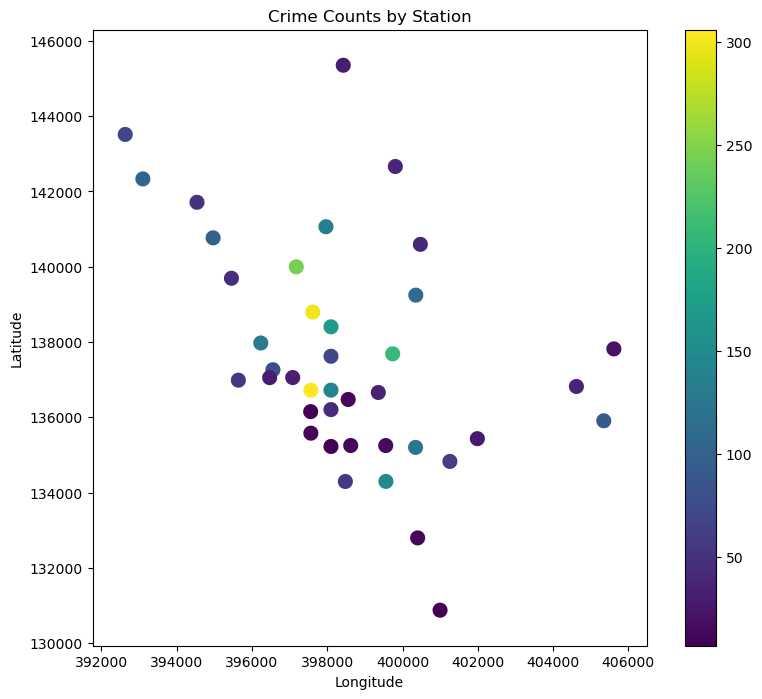

In [100]:
import matplotlib.pyplot as plt
#I can use matplotlib tool to make a chloropleth map. 

# Plotting the buffers with color based on the crime_count variable
fig, ax = plt.subplots(1, 1, figsize=(10, 8))
crimes_in_buffers.plot(column='crime_count', cmap='viridis', ax=ax, legend=True) # Defining the color and adding a legend 
plt.title('Crime Counts by Station') # Adding labels 
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

### 6.4 Implications and Further Studies
This chloropleth map has implications for the governance and organisation of resources for the transportation authority. It suggests that the station size is not a good predictor of crime, and that instead, there are several stations that are hotspots for crime. This is evidenced by the close proximity of a yellow point next to a green one, suggesting that resources should be devoted towards addressing and understanding the high crime rates in these two yellow stations. Additionally, an explanation for the relatively low crime rates in the largest stations could be greater police presence near government buildings, which the center of D.C. largely consists of. 

This aligns with the literature on crime rates in transportation nodes in D.C.; Irvin-Erikson and La Vigne note that passenger numbers, the frequency of rail service, and the design or security characteristics of the station are hugely impactful on the rates of crimes in and around these stations. Station size is a small factor in this, which likely explains the lack of a direct correlation. 

Next steps for this data would include analysing the differences in crime rates based on the time of day as well as the type of crime. All in all, it reinforces the conclusion that a multi-stakeholder approach to the complex crime problem in stations is needed. 

# DELETE THIS

In [ ]:
spatial_result.explore()

In [ ]:
# Add census data, classify which stations, which crime in the most relevant in which stations 
# Preprocessing before mapping along roads, bringing all the ledgers into one and mapping 
# Function crimes, trainsstation, numbher of lines
# doing regressions 

In [ ]:
import requests
import pandas as pd
import geopandas as gpd

# Describing the url for the Crime Incidents in 2022 dataset
url_jobs = "https://maps2.dcgis.dc.gov/dcgis/rest/services/DCGIS_DATA/Demographic_WebMercator/MapServer/42/query?outFields=*&where=1%3D1&f=geojson"
# Making the query to the web server, using the Get method from the requests library 
response = requests.get(url_jobs)
response

In [ ]:
data = response.json()
#data

In [ ]:
# From the above data, the dictionary is listed under features 
job_data = data['features']
job_pd = pd.DataFrame(job_data)
#job_pd

In [ ]:
# # # It looks like there are still structures under the properties and geometry column. Based on the documentation here: 
# https://pandas.pydata.org/docs/reference/api/pandas.json_normalize.html, I can use json_normalize 
from pandas import json_normalize

# Converting the list of dictionaries to a DataFrame, just in case
job_pd = pd.DataFrame(job_data)

# Using json_normalize to extract values from the 'properties' and the 'geometry' column
prop_norm = json_normalize(job_pd['properties'])
geo_norm = json_normalize(job_pd['geometry'])

# Concatenating the normalized data with the original DataFrame using pd.concat
job_pd = pd.concat([job_pd, prop_norm, geo_norm], axis=1)
#job_pd.head()

In [ ]:
# Based on the key provided by the dataset, I decided to keep two variables: 
# DP03_0052E = INCOME AND BENEFITS (IN 2021 INFLATION-ADJUSTED DOLLARS): Total households: Less than $10,000
# DP03_0007E = 16 and over not in labor force
# I also kept the ward (OBJECTID) and the coordinates column
keep_cols = [
    "OBJECTID",
    "coordinates",
    "DP03_0052E",
    "DP03_0007E",
]
job_pd = job_pd[keep_cols]
#job_pd

In [ ]:
# Checking to make sure the dtypes are accurate 
job_pd.dtypes

In [ ]:
import geopandas as gpd
from shapely.geometry import Polygon # I found the documentation for this here: https://shapely.readthedocs.io/en/stable/reference/shapely.Polygon.html. 
# Normally, we've been using points_from_xy, but because the coordinates are not split into x and y, it took some digging to find a way around this

all_coordinates = [coordinates for sublist in job_pd['coordinates'] for coordinates in sublist] 
# Also, I needed all the coordinates for all the polygons. Most shapely documentation uses index = 0, which would not give me the polygons for each ward, just the first one
# Therefore, I had to use the list comprehension documentation that I found here: https://docs.python.org/3/tutorial/datastructures.html
# 'the coordinates for sublist' line will go over each set of coordinates within each sublist 

# Now I have to make a list with all those little subsets 
polygons = [Polygon(coordinates) for coordinates in all_coordinates]

# Creating a GeoDataFrame
job_gdf = gpd.GeoDataFrame(job_pd)

# Now, I have to re-assign the list of Polygon objects to the 'geometry' column
job_gdf['geometry'] = polygons

# Dropping the coordinates column, because now we should have a geometry column
job_gdf = job_gdf.drop('coordinates', axis=1)

In [ ]:
job_gdf.head() # Now, we only have the geometry, 
#the households making under 10,000 dollars and the number of people over 16 not in the labor force by ward.

In [ ]:
crime_gdf.head() # Heres a sample of crime_gdf as a reminder

## 5.1 Plotting crime rates by wards

In [ ]:
crime_job_data.head()

In [ ]:
# As seen in the line above, the OFFENSE column includes a wide variety of different values. I'd like to just know the 
# number of thefts unrelated to cars by ward. 
filtered_points_gdf = crime_gdf[crime_gdf['OFFENSE'] == 'THEFT/OTHER'] # First, I have to make a subset of the original crime_gdf data by theft/other. 

joined = gpd.sjoin(filtered_points_gdf, job_gdf, op='within', how='left') # Now, I'm going to rejoin this with the employment data. 

# Counting the number of theft points within each polygon
thefts_by_ward = joined.groupby('WARD').size().reset_index(name='theft_by_ward')

print(thefts_by_ward) # Now, we just have to add this back into the original crime_job_data

In [ ]:
theft_job_data = crime_job_data.merge(thefts_by_ward, on='WARD', how='left') # Now, we add this back to the crime_job_data as a new column

In [ ]:
theft_job_data

In [ ]:
theft_job_data.explore()
# Unfortunately, this does not provide the boundaries of the wards themselves. 

In [ ]:
# Now, lets see how this looks like on a map. Using the same kmeans method, I can plot an interactive map that will also divide by wards. 
from sklearn.cluster import KMeans
num_clusters = 4

kmeans_collection = KMeans(n_clusters=num_clusters, random_state=42) 
theft_job_data['kmeans_cluster'] = kmeans_collection.fit_predict(theft_job_data[['theft_by_ward']]) # I edited this to reflect the data 

In [ ]:
import leafmap

m = leafmap.Map(center=(38.9072, -77.0369), # I had to look up the coordinates for Washington D.C. here. 
                zoom=11,
                draw_control=False,
                measure_control=False,
                fullscreen_control=False,
                attribution_control=True,
                   
               )

m.add_basemap("CartoDB.Positron")
m.add_data(
    spatial_result,
    column='kmeans_cluster',
    legend_title='Clusters',
    cmap='Set1',
    k=4,
)
m # This plots the map. As we can see, the thefts per ward is now a column that we can see. It seems that most thefts are concentrated in
# wards 1, 5, 6, and 2. Moreover, the wards on the outskirts of the city (4, 3, 7, and 8) have higher rates of unemployment. This could reflect 
# a relationship between wealth and crime, but more data is needed to understand the dynamics of travel from areas with less wealth and sites of theft-related crimes. 

### 3.4 Importing the ward-level boundaries

In [ ]:
# Using the same processes as above, I'm going to pull the ward boundaries from the same source using an API and then clean the data.

# Describing the url for the ward-boundaries dataset
url_ward = "https://maps2.dcgis.dc.gov/dcgis/rest/services/DCGIS_DATA/Administrative_Other_Boundaries_WebMercator/MapServer/53/query?outFields=*&where=1%3D1&f=geojson"
# Making the query to the web server, using the Get method from the requests library 
response = requests.get(url_ward)
data = response.json()
#data #--> The data is similar to the crime_gdf, with structures under the features column. 

In [ ]:
ward_data = data['features']
ward_pd = pd.DataFrame(ward_data)
ward_pd # Looks like we still need to normalise the data using the same json.normalise function.

In [ ]:
from_data_normalized = json_normalize(ward_pd['properties'])

# Concatenating the normalized data with the original DataFrame using .concat
ward_pd = pd.concat([ward_pd, from_data_normalized], axis=1)
ward_pd

In [ ]:
"""
It looks like the geometry column still has a nested structure. Based on the documentation found here: https://shapely.readthedocs.io/en/stable/manual.html,
I can use shape imported from shapely to return a new, independent geometry
"""
from shapely.geometry import shape
# Converting the 'geometry' to a Shapely Polygon object
polygon = shape(ward_pd['geometry'][0]) # The 0 selects the first element (index 0) from the 'geometry' column - this is the issue! 

# Creating a GeoDataFrame
ward_gdf = gpd.GeoDataFrame(ward_pd)

# Assigning the Shapely Polygon object to the 'geometry' column
ward_gdf['geometry'] = polygon
ward_gdf

In [ ]:
# There are lots of repeated columns, so we can use the keep_col to choose the necessary ones 
keep_cols = [
    "WARD",
    "geometry",
]
ward_gdf = ward_gdf[keep_cols]
ward_gdf

In [ ]:
ward_gdf = ward_gdf.set_geometry('geometry')
ward_gdf.explore()

In [ ]:
# We can do this with leafmap. 
import leafmap

m = leafmap.Map(center=[54, -1], zoom=6)
m.add_gdf(crime_gdf, layer_name="Crime")
#m

# 6. Additional Charts 
Complement with additional charts (line charts, bar charts, etc.) to extend the map and highlight key trends or patterns in the data.

In [ ]:
offense_counts_in_buffers = spatial_result['OFFENSE'].value_counts()
print(offense_counts_in_buffers)

# Dealing with big data sets

You have likely noticed the difficulties we face when attempting to plot data using traditional libraries with built-in mapping representation methods. Every time a new variable is loaded, your computer's memory pool becomes increasingly crowded. As spatial data scientists, we may end up consuming all of our available RAM, causing Jupyter to become stuck. Additionally, the notebooks become quite large in size, and it becomes difficult to push the final version into platforms like GitHub.

In such cases, desktop tools are typically more efficient when it comes to manipulating and handling a certain amount of data, but they, too, can become stuck. These programs, such as `QGIS`, `ArcGIS`, and even `R`, struggle to handle large datasets, especially those with over a million records. Therefore, we need to consider alternative methods for processing and plotting data.

> If you took the GG3209 module last semestre you will be familiar with this section

# Lonboard

Now, we can download big data sets related to reported crime in the UK. This data can be found in the following link https://data.police.uk/data/, you can select a range of times and then the force that you would like to get the data. For this example, we can download the reported crime from **Jan 2023 to Dec 2023** collected by the Metropolitan Police Service.

> Please **go to this website and download the data**, place the zip file in your data folder and keep working with the notebook. Once you unzip and merge all the files from Jan to Dec 2023, you should get approximately 1.135.031 records.

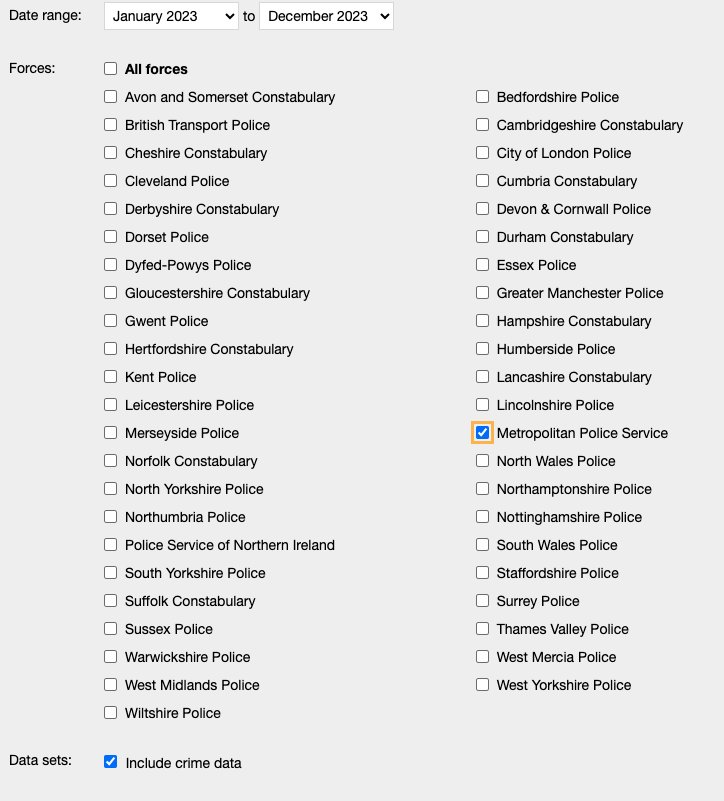



We need to unzip, go through all the sub-directories and then merge all the CSV files included.



In [ ]:
import zipfile
import os
import pandas as pd

# Unzip the file. YOU NEED TO UPDATE THIS PATH based on where you place the zip file.
with zipfile.ZipFile('data/5990abe009b7d3c691315fa106efb78027d13c95.zip', 'r') as zip_ref:
    zip_ref.extractall('data/CrimeData')

# List all .csv files in subdirectories
# Here we use https://docs.python.org/dev/library/pathlib.html and walk https://docs.python.org/dev/library/os.html#os.walk
csv_files = [os.path.join(root, file) for root, dirs, files in os.walk('data/CrimeData') for file in files if file.endswith('.csv')]

# If you notice, the files are included in separate folders; we need to merge (concat) those.
crimes_london = pd.concat([pd.read_csv(csv_file) for csv_file in csv_files], ignore_index=True)

crimes_london.head()

In [ ]:
len(crimes_london)

You should have more than 1M of records.

In [ ]:
crimes_london.shape

In [ ]:
crimes_london.columns

Let's filter the requiered columns, and then geo-locate the outcome.

In [ ]:
subset_crimes = crimes_london[['Reported by', 
                            'Longitude',
                            'Latitude',
                            'LSOA code',
                            'LSOA name',
                            'Crime type',
                           ]]

# Remove any records that are not complete
subset_crimes = subset_crimes.dropna()
# We need a crime_id attribute.

subset_crimes['crime_id'] = range(len(subset_crimes))


In [ ]:
subset_crimes.head()


After the initial pre-processing, you have significantly less amount of data records. 







In [ ]:
subset_crimes.shape

In [ ]:
import geopandas as gpd
geometry = gpd.points_from_xy(subset_crimes['Longitude'], subset_crimes['Latitude'])
geo_crimes = gpd.GeoDataFrame(subset_crimes, geometry=geometry, crs='EPSG:4326')
geo_crimes.head()

To plot more than 1 million points, traditional methods are not a good choice. Instead, we can use advanced libraries like [lonboard](https://developmentseed.org/lonboard/latest/) to create a layer variable that utilizes the `geo_crimes` and plot it on an interactive map. This library offers two methods: `viz(gdf)` - a quick method to plot big datasets, and `ScatterplotLayer` - a method that provides more control over the layer's appearance. With this method, we can create a `layer` and customize its visualization using other methods in the library. Additionally, we can load several layers, including lines and polygons.

>Uncomment and run the next line once you install lonboard. Ideally this libary should be part of the UA environment we have or we can run the same line in another terminal, before lauching Jupyter.

In [ ]:
#pip install lonboard

In [ ]:
from lonboard import viz
viz(geo_crimes)

You are mapping more than 1M of records, if you want you can try that in QGIS or R and let me know the results

In [ ]:
from lonboard import Map, ScatterplotLayer

layer = ScatterplotLayer.from_geopandas(geo_crimes)
map = Map(layers=[layer], _height=500)
map

if you get an error, go to the documentation website and see what are you missing: https://developmentseed.org/lonboard/latest/api/layers/scatterplot-layer/

## Customizing the Layer

Now, we can customize the previous layer by plotting by `Crime type` in an initial attempt to unhide any spatial pattern. Let's initially check how many categories we have in this `Crime type` column.


In [ ]:
crime_type = geo_crimes['Crime type'].value_counts()
crime_type

In [ ]:
import seaborn as sns
geo_crimes.groupby('Crime type').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))

We can see that `Violence and sexual offences ` are the Crime Types with more reports. now, let's see if we can see any spatial pattern by plotting those categories in our previously loaded map. We need to assign a colour to each crime type to do this. We can do that by creating an array of all the unique categories.

In [ ]:
categories = geo_crimes['Crime type'].unique()
colors = sns.color_palette("bright", len(categories))
colors

Now using the same principle, we can use Numpy to create a matrix that group every `Crime type` with its correspondant `color code. ` This code will use the coding `RGBA(Red, Green, Blue,Alpha)` the last value corresponde to transparency.

In [ ]:
# Get unique categories
categories = geo_crimes['Crime type'].unique()

# colour seaborn's "tab10" color palette
colors = sns.color_palette("bright", len(categories))

# We create a dictionary to map categories to colours
color_dict = dict(zip(categories, colors))
color_dict

With this new array filled of the code colours we need per Crime type category. We can then use the layer. properties, e.g, `radius_scale`, `opacity`, and `get_fill_color`. You need to code back to the map to see the customised layer in the map we plot previously.

In [ ]:
import numpy as np
color_array = np.array([tuple(np.append(
    np.multiply(
        color_dict.get(x, (0, 0, 0)), 255).astype(int), 255)) 
                        for x in geo_crimes['Crime type']],
                       dtype=np.uint8)
color_array

In [ ]:
layer.radius_scale = 40
layer.opacity = 0.05
layer.get_fill_color = color_array

> to see the updated and coloured map you need to scroll up and see the plot map we previously created.

The Metropolitan Police Service collects data from multiple areas, so the map includes data from areas outside London; we could define a new bounding box to focus only on the Central London area.

In [ ]:
geo_crimes.total_bounds

By using the tool https://norbertrenner.de/osm/bbox.html to get the precise boundary box you need to spatially filter your analysis and remove any outlier rows that are not located in the area of interest. 

In [ ]:
import shapely
ld_bbox = [-0.591,51.285,0.381,51.678] # London B. Box
geo_crimes_london = geo_crimes[geo_crimes.intersects(shapely.box(*ld_bbox))]
geo_crimes_london.shape

In [ ]:
layer = ScatterplotLayer.from_geopandas(geo_crimes_london)
map = Map(layers=[layer], _height=500)
map

# PyDeck

deck.gl is a **WebGL-powered** framework for visual exploratory data analysis of large datasets. You can install the entire framework on you computer an run it locally, which will be the rigth way if you are creating an app from scratch. Here we will use PyDeck, which is a set of Python bindings for making spatial visualizations with **deck.gl**, optimized for a Jupyter environment. See the documentation: https://pydeck.gl/

> First, we need to install the library in our UTA environment, something you are already familiar with. Uncomment the next code cell and run it only once.


In [ ]:
#pip install pydeck

If you have issues installing it, please visit: https://pydeck.gl/installation.html or ask for an appoinment to get extra help.

In [ ]:
import pydeck as pdk

# 2014 locations of car accidents in the UK
UK_ACCIDENTS_DATA = ('https://raw.githubusercontent.com/uber-common/'
                     'deck.gl-data/master/examples/3d-heatmap/heatmap-data.csv')

#This data has already been curated and adapted to this example. In the real world, you need to do the data cleaning and pre-processing part.

In [ ]:
# Define a layer to display on a map
layer = pdk.Layer(
    'HexagonLayer',
    UK_ACCIDENTS_DATA,
    get_position=['lng', 'lat'],
    auto_highlight=True,
    elevation_scale=50,
    pickable=True,
    elevation_range=[0, 3000],
    extruded=True,                 
    coverage=1)

In [ ]:
# Set the viewport location, see here for more properties https://pydeck.gl/view_state.html?highlight=viewstate#pydeck.bindings.view_state.ViewState
view_state = pdk.ViewState(
    longitude=-1.415,
    latitude=52.2323,
    zoom=6,
    min_zoom=5,
    max_zoom=15,
    pitch=40.5,
    bearing=-27.36)

In [ ]:
# Render
r = pdk.Deck(layers=[layer], initial_view_state=view_state)
r.to_html('MyGeoApp.html')
# NOTE: You are creating an HTML ( website with this app) so you can see them out of the Jupyter environment. 

# Challenge 3

1. Go to https://data.cityofnewyork.us/Public-Safety/Motor-Vehicle-Collisions-Crashes/h9gi-nx95/about_data 
2. Get the data for Motor Vehicle Collisions - Crashes Jan 2024. The dataset contains 2.06 M of records.
3. Use the API endpoint to map the data (e.g. https://data.cityofnewyork.us/resource/h9gi-nx95.json) 
   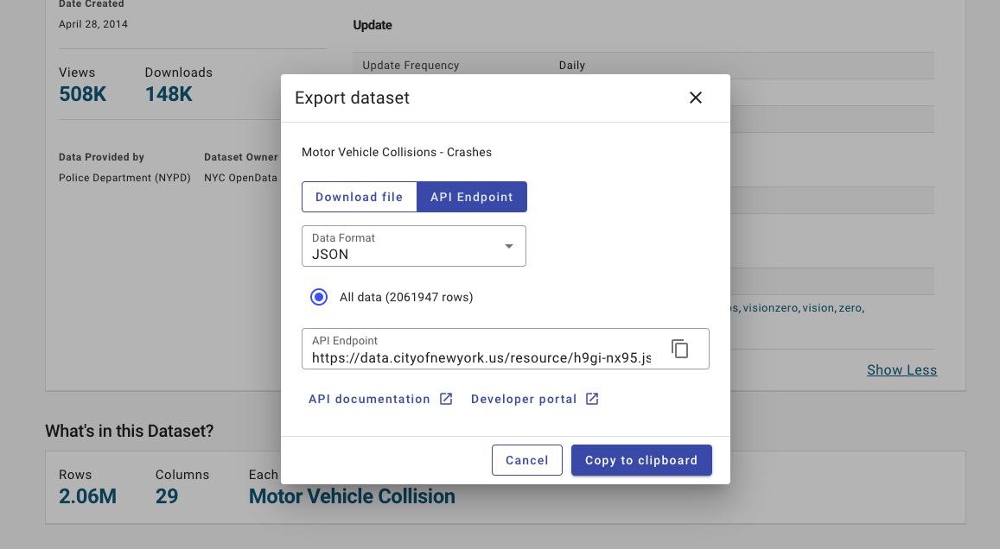
4. Customize the map by representing the data by `number_of_persons_killed` and `number_of_cyclist_killed`
5. Finally, calculate descriptive statistics for at least two attributes, such as `mean`, `standard deviation`, and other relevant measures 6. Justify/Describe the attribute selection.
7. Plot correlations between the chosen attributes and create `univariate` and/or `multivariate` charts to justify your insights.
   > Please take note that the dataset includes various numerical values. Hence, each student's attribute selection, justification, charts, and maps are expected to vary. 

## 2. Getting the data 

In [ ]:
#api: https://data.cityofnewyork.us/resource/h9gi-nx95.json
"""
3. Challenge 3. If you are trying to get the 2.6M of records, 
you probably already figured that the request only gives you 1k records. 
This is very common in APIs for security reasons; no one will allow strange
rs to fetch massive amounts of data without a token or secured access. If you 
click on the API documentation, you will see it is clearly stated (see attached figur
e). So what you need is to sign up and then get a token (Generating App Tokens and API Keys –
Data & Insights Client Center (socrata.com); if you take more time reading the API documentat
ion, which is what I expect (Motor Vehicle Collisions - Crashes | Socrata API Foundry), 
you awill see they actually give you the code to add your token and request all the data in
Pandas (better than ChatGPT ¯\_(ツ)_/¯).

You should be able to fetch the 2.6M of records, but based on what
I have seen from some of your personal computers and their capacity, I woul
d suggest you try to fetch only 1M records to make your machine and Jupyter able
to manage such requests. But if you think your machine has enough RAM to handle the 
full request, go ahead. It will take time, though! So if you make the request constantly,
you will have to wait a lot, so try first with a small limit like 50K, code what you need, and
just when you know what you are going to do, run the full request for the big data sets of 1M or 2M

"""

In [ ]:
#https://data.cityofnewyork.us/resource/h9gi-nx95.json?crash_date=2014-01-21T00:00:00.000

In [ ]:
# Based on the documentation from the website provided, here is the code for pulling the data with a token. 
import pandas as pd
from sodapy import Socrata

# Unauthenticated client only works with public data sets. Note 'None'
# in place of application token, and no username or password:
client = Socrata("data.cityofnewyork.us", "2ibzJzKj3i6OoHoAmTm1Ui3I8")

# Example authenticated client (needed for non-public datasets):
#client = Socrata(data.cityofnewyork.us,
 #                 2ibzJzKj3i6OoHoAmTm1Ui3I8,
 #                 username="ibk1@st-andrews.ac.uk",
   #               password="4fAu@rYj@^^P4!Ha")
#
# First 50k results, returned as JSON from API / converted to Python list of
# dictionaries by sodapy.
results = client.get("h9gi-nx95", limit=2000000) 

# Convert to pandas DataFrame
mvc_df = pd.DataFrame.from_records(results)
len(mvc_df)

In [ ]:
mvc_df.columns

## 3 Using the API endpoint to map the data 

### 3.1 Subsetting the Data

In [ ]:
subset_crashes = mvc_df[['number_of_persons_injured', # Let's first subset all the relevant variables of crash data that we might analyse. 
                        'longitude',
                        'latitude',
                        'number_of_persons_killed',
                        'number_of_pedestrians_injured',
                        'number_of_cyclist_injured',
                        'number_of_cyclist_killed',
                        'number_of_motorist_injured',
                        'number_of_motorist_killed',
                           ]]

#Now, I'm going to drop any NaN values from the columns: 
subset_crashes = subset_crashes.dropna()

subset_crashes.head()

### 3.2 Creating A GeoDataFrame 

In [ ]:
geometry = gpd.points_from_xy(subset_crashes['longitude'], subset_crashes['latitude'])
geo_crashes = gpd.GeoDataFrame(subset_crashes, geometry=geometry, crs='EPSG:4326')
geo_crashes = geo_crashes.drop('longitude', axis=1)# Lets make sure to drop the lat and long columns now that we have the geometry 
geo_crashes = geo_crashes.drop('latitude', axis=1)
geo_crashes.head()

### 3.3 Map Vizualisation 

In [ ]:
from lonboard import viz
viz(geo_crashes) # When I first did this, the map would start over the entire extent of North America 

## 4. Customization 

### 4.1 Subsetting the map by persons and cyclists killed 
Customize the map by representing the data by number_of_persons_killed and number_of_cyclist_killed

In [ ]:
"""
from lonboard import Map, ScatterplotLayer

layer = ScatterplotLayer.from_geopandas(geo_crimes)
map = Map(layers=[layer], _height=500)
map

crime_type = geo_crimes['Crime type'].value_counts()
crime_type


import seaborn as sns
geo_crimes.groupby('Crime type').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))


categories = geo_crimes['Crime type'].unique()
colors = sns.color_palette("bright", len(categories))
colors



# Get unique categories
categories = geo_crimes['Crime type'].unique()

# colour seaborn's "tab10" color palette
colors = sns.color_palette("bright", len(categories))

# We create a dictionary to map categories to colours
color_dict = dict(zip(categories, colors))
color_dict

import numpy as np
color_array = np.array([tuple(np.append(
    np.multiply(
        color_dict.get(x, (0, 0, 0)), 255).astype(int), 255)) 
                        for x in geo_crimes['Crime type']],
                       dtype=np.uint8)
color_array
"""

In [ ]:
# Because we want to see just the persons and cyclists killed, let's filter the original dataset once more. 
crash_deaths = mvc_df[[
                            'number_of_persons_killed',
                            'number_of_cyclist_killed',
                            'longitude',
                            'latitude',
                           ]]
crash_deaths = crash_deaths.dropna()
geometry = gpd.points_from_xy(crash_deaths['longitude'], crash_deaths['latitude'])
crash_deaths_geo = gpd.GeoDataFrame(crash_deaths, geometry=geometry, crs='EPSG:4326')
crash_deaths_geo = crash_deaths_geo.drop('longitude', axis=1)# Lets make sure to drop the lat and long columns now that we have the geometry 
crash_deaths_geo = crash_deaths_geo.drop('latitude', axis=1)
crash_deaths_geo.head()

In [ ]:
# Lets check the dtypes
crash_deaths_geo.dtypes

In [ ]:
# Persons and cyclists killed should be int, not objects or str. 
crash_deaths_geo.number_of_persons_killed = crash_deaths_geo.number_of_persons_killed.astype(int)
crash_deaths_geo.number_of_cyclist_killed = crash_deaths_geo.number_of_cyclist_killed.astype(int)

In [ ]:
# At this point, we have points for all the crashes, even if there were no deaths. Therefore, we need to filter out the '0' values for both the number of persons killed and number of cyclists killed. 
# That means we need to filter the data again: 
crash_deaths_geo = crash_deaths_geo[(crash_deaths_geo['number_of_persons_killed'] >= 1) & (crash_deaths_geo['number_of_cyclist_killed'] >= 1)]

In [ ]:
crash_deaths_geo.shape # Looks like there are only over a hundred or so deaths from crashes. 

In [ ]:
# Because there are so few deaths from crashes, using lonboard or another tool that's built for millions of data points is likely not relevant or useful. 

In [ ]:
crash_deaths_geo.explore()

### Note to delete this - attempt to change the colors of the deaths in the large dataset. 

In [ ]:
"""
# However, what we can do is plot all the data points and highlight the ones that resulted in the death of a cyclist and person. 
categories = geo_crashes['number_of_persons_killed'].unique()
colors = sns.color_palette("bright", len(categories))
colors
# We create a dictionary to map categories to colours
color_dict = dict(zip(categories, colors))
color_dict

import numpy as np
color_array = np.array([tuple(np.append(
    np.multiply(
        color_dict.get(x, (0, 0, 0)), 255).astype(int), 255)) 
                        for x in geo_crashes['number_of_persons_killed']],
                       dtype=np.uint8)
color_array
layer.radius_scale = 40
layer.opacity = 0.05
layer.get_fill_color = color_array
"""

In [ ]:
# To provide proof of concept, here is the method with lonboard scatterplots. 
# This is visualising all the traffic incidents in the data set, so 2000000 points. 
from lonboard import Map, ScatterplotLayer

layer = ScatterplotLayer.from_geopandas(geo_crashes)
map = Map(layers=[layer], _height=500)
map

In [ ]:
# This is visualising just the traffic incidents that resulted in the death of a person, as well as those that involved a cyclist death. 
from lonboard import Map, ScatterplotLayer

layer = ScatterplotLayer.from_geopandas(crash_deaths_geo) # calling the subsetted geodataframe from earlier. 
map = Map(layers=[layer], _height=500)
map

## 5. Descriptive Statistics for Two Attributes
Mean, standard deviation, and other relevant measures 

In [ ]:
mvc_df.head()

In [ ]:
# I want to calculate the descriptive statistics for the crash_time and the number of persons injured. My hypothesis is that times around twilight or at night are 
#far more likely to result in pedestrian injuries. In a sense, I expect a relationship between adverse road conditions and severity of incident. 

### 5.1 Subsetting a gdf with crash_time and injuries 

In [ ]:
import geopandas as gpd
injuries_time = mvc_df[[
                            'crash_time',
                            'number_of_persons_injured',
                            'longitude',
                            'latitude',
                           ]]
injuries_time = injuries_time.dropna()
geometry = gpd.points_from_xy(injuries_time['longitude'], injuries_time['latitude']) #Creating a geodataframe
injuries_time = gpd.GeoDataFrame(injuries_time, geometry=geometry, crs='EPSG:4326')
injuries_time = injuries_time.drop('longitude', axis=1)# Lets make sure to drop the lat and long columns now that we have the geometry 
injuries_time = injuries_time.drop('latitude', axis=1)
injuries_time.head()

In [ ]:
# Let's check the dtypes 
injuries_time.dtypes

In [ ]:
# Crash_time should be a datatime, which injuries should be an int 
injuries_time.number_of_persons_injured = injuries_time.number_of_persons_injured.astype(int)
injuries_time['crash_time'] = pd.to_datetime(injuries_time['crash_time'], format='%H:%M') # We did this in a previous lab with glasgow bikes data. I removed the other time markers because we've only been provided with the hours and the minutes, not seconds or years, for example. 

In [ ]:
injuries_time.head()

In [ ]:
# I am only interested in the hours that injuries occured. From this documentation, I can extract just the hours 
# https://pandas.pydata.org/docs/reference/api/pandas.Series.dt.hour.html
injuries_time['crash_hour'] = injuries_time['crash_time'].dt.hour
# Let's remove the crash_time column and just use the crash_hour column. 
injuries_time = injuries_time.drop('crash_time', axis=1)
injuries_time

### 5.2 Descriptive Stats for Hour of Crash

In [ ]:
descriptive_stats = injuries_time.describe()
descriptive_stats

In [ ]:
# There are too many decimal points. From this documentation, I can round this table. 
descriptive_stats.round(2)

In [ ]:
#Using .mean
mean_hour = injuries_time['crash_hour'].mean()

print(mean_hour) # Need a reason for why this might not be relevant 

In [ ]:
mean_persons_injured = injuries_time['number_of_persons_injured'].mean()
print(mean_persons_injured) # On average, approximately a third of all accidents result in injuries

## 6. Justify/Describe the attribute selection.

### 6.1 Justification
The hour of the crash provides insight into the temporal distribution of crashes. On the other hand, the number of persons injured can serve as a proxy for the severity of the crash, and thus selecting both these attributes will provide insight into the relationship between thinform pole time and the severity on crash. In turn, this might inform policy makers on the times that crashes result in the worst human health impact, which could offer insights on when to employ more ambulances or traffic police, for example. 

In [ ]:
# To shed light on this relationship, I'm going to count the number of crashes by the hour and then count the number of injuries by the hour. 
# Relationship between the number of total crashes and the hour: I can do this with groupby by counting the number of events in each category (ie hour) 
crashes_per_hour = injuries_time.groupby('crash_hour')['number_of_persons_injured'].sum()
print(len(injuries_time))
crashes_per_hour # Looks like 17:00 is the hour in which the most injuries occur. This aligns with rush hour traffic, most likely. 

In [ ]:
injuries_time.head()

In [ ]:
# However, I am interested to see if the distribution of injuries is different based on the hour. This would track the severity of the accident; perhaps more crashes occur in 17:00, but they could result in more injuries at different times. 
# This means I need to filter the injuries to exclude the accidents that did not result in an injury. 
# We can filter this with .loc 
injuries_per_hour = injuries_time.loc[injuries_time['number_of_persons_injured'] >= 1] # Greater than or equal to 1 to exclude the crashes that did not result in an injury 

In [ ]:
injuries_per_hour.head()

In [ ]:
injuries_per_hour_sum = injuries_per_hour.groupby('crash_hour')['number_of_persons_injured'].sum()
injuries_per_hour_sum

In [ ]:
# I expected that the number of crashes would vary throughout the day. 

## 7. Correlations and Univariate/Mulitvariate Charts

In [ ]:
correlation = injuries_time['number_of_persons_injured'].corr(injuries_time['crash_hour'])
print("Correlation between number of persons injured and crash hour:", correlation)

In [ ]:
# Before we do this, we need to check the dtypes  
geo_crashes.dtypes
# Looks good; int64 and geometry are correct. 

In [ ]:
# Check the bounds, check for nan values, use bbox finder 

In [1]:
geo_crashes.head()

NameError: name 'geo_crashes' is not defined

In [ ]:
descriptive_stats = subset_crashes.describe()
descriptive_stats

In [ ]:
subset_crashes

In [ ]:
fire_incident = subset_listings['neighbourhood_cleansed'].value_counts()
neighborhood_counts
# Here for the complete doc https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.crosstab.html 
cross_tabulation = pd.crosstab(subset_listings['neighbourhood_cleansed'], subset_listings['bedrooms'])
cross_tabulation

# Datashader

Datashader is a graphics pipeline system for creating meaningful representations of large datasets quickly and flexibly. Datashader breaks the creation of images into a series of explicit steps that allow computations to be done on intermediate representations. 
There are other popular tools to represent big datasets like HoloViz; Datashader is included in this extended framework to allow researchers to represent millions of records.

## Why is mapping big data sets so complicated?

1. The speed. Plotting the 11 million data points from the below example using regular Python tools would be slow and may crash Jupyter kernel.
2. Image quality. In case a plotting library doesn't crash and you are willing to wait, it may still keep drawing each new data point as a circle or any other shape on top of each other, causing over-plotting. That is the main issue of plotting big data in GIS tools. Even if you add  transparency for overlapping points, it may not always help in this situation. Just imagine having many points displayed on top of each other on an image - what you would see it would become complicated to extract information from it.

**Datashader** provides an elegant and seemingly magic solution to these two obstacles. 


> Before you continue. I advise to save your work and **restart the kernel** as you must have a lot of your memory occupied.

Let's start with a simple example using data from the NYC Taxi data (https://www.nyc.gov/site/tlc/about/tlc-trip-record-data.page)

> For more info go to: https://examples.pyviz.org/nyc_taxi in here they use HoloViz, if time allow I will show you how to use that tool as well.

We need to make sure our Python env includes all the libraries we need. In a new terminal CD to your Working Directory/Repo and run 
`conda install holoviews hvplot datashader fastparquet python-snappy`

And then import packages:

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
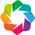

In [41]:
import holoviews as hv, pandas as pd, colorcet as cc
from holoviews.element.tiles import EsriImagery
from holoviews.operation.datashader import datashade
hv.extension('bokeh')

**Reading the data**:

For the very largest files, you will want to use a distributed processing library like **Dask with Datashader**, but here we have a **Parquet file** with “only” **11 million records**, which Datashader can easily handle on a laptop using Pandas without any special computing resources. Here you’ll load in two columns representing taxi drop-off locations.

In [27]:
#GeoParquet is a helpful format for loading big data sets.

df = pd.read_parquet(
    'https://s3.amazonaws.com/datashader-data/nyc_taxi_wide.parq',
    columns = ['dropoff_x', 'dropoff_y']
)

In [ ]:
df.head() # This will take some time, you are loading more than 11M records.

In [ ]:
len(df)

In [28]:
df.dtypes

dropoff_x    float32
dropoff_y    float32
dtype: object

**You have loaded 11M of records**, but now see how fast you will be able to plot all of them.

**Mapping**: 

Now we plot the data using **Datashader**. It only took four lines of code and six milliseconds to plot the 11 million rows of data, overlaid on a map of the New York area:

In [47]:
%%time
map_tiles = EsriImagery().opts(alpha=0.5, width=900, height=480, bgcolor='black')
points = hv.Points(df, ['dropoff_x', 'dropoff_y'])
taxi_trips = datashade(points, cmap=cc.fire, width=900, height=480)
map_tiles * taxi_trips

CPU times: user 4.38 ms, sys: 5.5 ms, total: 9.88 ms
Wall time: 9.74 ms


:DynamicMap   []
   :Overlay
      .Tiles.I :Tiles   [x,y]
      .RGB.I   :RGB   [dropoff_x,dropoff_y]   (R,G,B,A)

Alternatively, instead of using **thedatashade function**, You could use **hvplot** with `rasterize=True` to apply rasterization using Datashader! 

I highly recommend using `hvplot` for your visualizations.

In [38]:
import hvplot.pandas

map_tiles = EsriImagery().opts(alpha=0.5, width=900, height=480, bgcolor='black')
plot = df.hvplot(
    'dropoff_x',
    'dropoff_y',
    kind='scatter',
    rasterize=True,
    cmap=cc.fire,
    cnorm='eq_hist'
)
map_tiles * plot

NameError: name 'df' is not defined

You would then be able to `zoom in` to any region of this map, with the plot dynamically updating to use the full resolution for that zoom level.


**Datashader** turns your data into a plot using the five-step pipeline we discussed in the lecture.

You can find more information about how the pipeline works in each step on the Dashader Documentation site. (https://datashader.org/user_guide/Extending.html

1. Projection
2. Aggregation
3. Transformation
4. Colormapping and,
5. Embedding.

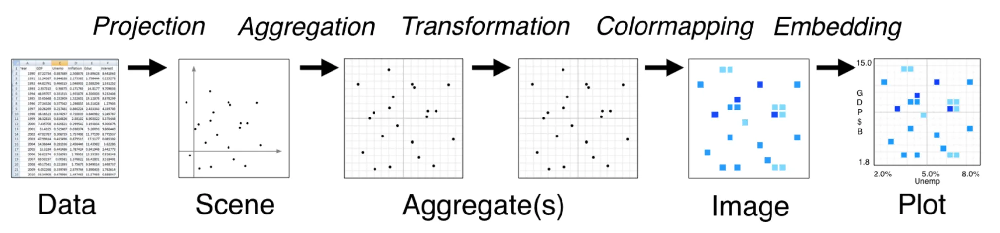
Fig 1. Datashader pipeline (Image from datashader.org).

Now we can break down each step you can see how the data is processed., Take some time to print and explore the outcomes.

In [ ]:
#Importing the required libraries.
import datashader as ds
import datashader.transfer_functions as tf
from holoviews.operation.datashader import rasterize

**Projection:** First, a 2D canvas is defined with width and height for the data to be projected onto.

The canvas defines **how many pixels** we would like to see in the final image, and optionally defines the `x_range` and `y_range` that will map to these pixels. 

In this particular scenario, the data ranges needed to plot are not specified in the Canvas. However, they will be automatically filled in the next step based on the maximum and minimum values of the data x and y in the given dataframe. The projection is defined by the Canvas, but for the sake of speed, each point is projected during the aggregation step.


In [ ]:
canvas = ds.Canvas(plot_width=900, plot_height=480)
canvas

**Agregation**: 

After we define the projected canvas, we project each point into the two-dimensional output grid and aggregate the results per pixel.

Datashader provides various options for data aggregation, but in this particular example, we are counting the number of data points projected into each pixel. To do this, we iterate through the data points and increment the pixel where the point lands. This creates a two-dimensional histogram that counts dropoffs per pixel.

In [ ]:
canvas.points(df, 'dropoff_x', 'dropoff_y', agg=ds.count())

**Transformation:** This is an optional step. 

The previous step has resulted in a fixed-size grid, regardless of the original dataset size. Once the data is in this grid, it can be transformed in any way desired, such as selecting a specific range of counts, masking data based on other datasets, or values, etc. In this case, the dropoff data ranges from zero in some pixels to tens of thousands in others. If we try to plot the grid directly, we would see only a few hotspots. Therefore, to make all the different levels visible, the data is transformed using the `image-processing` technique called **histogram equalization**. This technique reveals the distribution of the counts rather than their absolute values, making all the different levels visible, as seen in the image above.

Histogram equalization is actually folded into the colormapping step below, but we can do explicit transformations at this stage if we want, such as squaring the counts

In [ ]:
import numpy as np
np.power(canvas.points(df, 'dropoff_x', 'dropoff_y', agg=ds.count()),2)

**Color Mapping**

After the binning process, we can represent the binned grid data as an image. 

This is the key part, each bin value can be mapped to one of the 256 colors in a colormap, either through **linear interpolation** or an automatic transformation like applying the log function to each bin value, or using histogram equalization. 

In this example, we are using the "fire" colourmap from Colorcet. The colourmap starts with black for the lowest counts (1 and 2 dropoffs) and gradually shifts to red for higher values (in the hundreds), then yellow for even higher values (in the thousands), and finally white for the highest counts per pixel (in the tens of thousands, in this case). We set the background to black to enhance the visibility of the data.

Similar approach we did earlier with londboard

In [ ]:
import datashader.transfer_functions as tf
tf.set_background(
    tf.shade(
        canvas.points(df, 'dropoff_x', 'dropoff_y', agg=ds.count()),
        cmap=cc.fire),
    'black')

And **Embedding:**

As you can see, Datashader only renders the data, not any axes, colour bars, or similar features you’d expect in a complete plot.

To add features that help interpret data, we can embed the images generated by Datashader into a plot. The easiest way to do this is to use **HoloViews**, which is a high-level plotting API that allows you to use `Matplotlib`, `Bokeh`, or `Plotly` as the backend. 

An example of using **HoloViews** to define a "points" object and then datashade all the points is shown below. Alternatively, you can use the **rasterize** method instead of **datashade** to let `Bokeh` handle the transformation and colormapping steps, enabling hover and colorbars to function properly.

In [ ]:
map_tiles = EsriImagery().opts(alpha=0.5, width=900, height=480, bgcolor='black')
points = hv.Points(df, ['dropoff_x', 'dropoff_y'])
ropts = dict(tools=['hover'], colorbar=True, colorbar_position='bottom', cmap=cc.fire, cnorm='eq_hist')
taxi_trips = rasterize(points).opts(**ropts)
map_tiles * taxi_trips

## Why Datashader is so fast?

Datashader is able to perform quickly because it uses **GeoParquet files**. If your data is in the form of JSON or CSV files, this can be memory-intensive. The Parquet file format is ideal for columnar data such as dropoff points, as it is compact, loads quickly, efficiently reads only the necessary columns and ranges, and supports distributed and out-of-core operation when required. 

The second reason for this fast representation is the combined **projection and aggregation** step. This step requires calculating values for millions of data points, but all subsequent calculations use the final fixed-size grid and are therefore much faster.


# Challenge 4

1. You worked with two modern libraries to map big data. Can you describe the differences between working with Longboard and Datashader? Which one provides the most exciting functionality, and how do the outcomes from both of them vary?
2. Find a large dataset with at least 5 million records. Consider open datasets, government datasets, or any dataset of interest to you. Ensure the dataset is in a format that can be easily loaded into a Pandas DataFrame (Parquet file or another format).
3. Define a potential problem or scenario for mapping this dataset.
4. Load the dataset into a Pandas DataFrame and explore its structure. Here, **I advice you! to take a small portion of that rather than work with the entire table.**
5. Identify key variables of interest that could be effectively visualized using Datashader(https://datashader.org/index.html#). (e.g. is fine if the datasets have only locations, but we are aiming for at least one additional variable to represent in the map. 
6. Use the previous steps and the Datashader documentation to implement a `hvplot` Map.
7. Discuss/Write any challenges you have encountered related to the challenges and how you addressed them.
8. As always. Provide clear comments and/or citations in your code, explaining each step of the Datashader implementation (**Note: You don't need to run the Datashader pipeline**)
   
9. **For next week**, create a **four-slide presentation** summarizing the problem, data source, dataset, challenges, map, and insights from visualizing the large dataset. **Two slides for Challenge 2** and the **other two for this challenge**. You can also use the Notebooks as a tool to make your presentation. 

## 1. Lonboard and Datashader Differences 
1. You worked with two modern libraries to map big data. Can you describe the differences between working with Longboard and Datashader? Which one provides the most exciting functionality, and how do the outcomes from both of them vary?

## 2. Dataset Finding 
Task: Find a large dataset with at least 5 million records. Consider open datasets, government datasets, or any dataset of interest to you. Ensure the dataset is in a format that can be easily loaded into a Pandas DataFrame (Parquet file or another format).

The dataset that I picked is the [NYPD Calls for Service Year to Date](https://data.cityofnewyork.us/Public-Safety/NYPD-Calls-for-Service-Year-to-Date-/n2zq-pubd/about_data). This data represents all the calls from residents of NYC to the 911 Emergency Dispatcher in 2023. It geolocates these calls and adds a description of what the caller is reporting. It also includes the date of the incident, the time of the dispatch and arrival, and whether the crime is currently occuring (ie. the cip_jobs column). 

## 3. Potential Problem 
A potential problem for this dataset is for the NYPD to determine where calls are mostly coming from across the city and whether they are reporting on a crime in progress. This might allow the agency to allocate resources; for example, if most calls that report on a crime-in-progress occur in one neighborhood or business district, then the NYPD could station more police officers or conduct effective public education campaigns on bystander syndrome and so on.  

!! Consider finding literature on this !!

## 4. Loading the Dataset
Exploring the structure of calls_df.

In [20]:
# https://data.cityofnewyork.us/resource/n2zq-pubd.json # This is the API they provided for the calls for service dataset. 
#This code is based on the documentation from the website provided by socrata: https://dev.socrata.com/foundry/data.cityofnewyork.us/h9gi-nx95
import pandas as pd
from sodapy import Socrata

# Unauthenticated client only works with public data sets. Note 'None'
# in place of application token, and no username or password:
client = Socrata("data.cityofnewyork.us", "B2WSuHf3qur9jJ3z8IMhmcrYB")

# 5,000,000 results, returned as JSON from API / converted to Python list of
# dictionaries by sodapy.
results = client.get("n2zq-pubd", limit=5000000) # While the dataset has over 7m points, I've decided to use 5m for memory purposes. 

# Convert to pandas DataFrame
calls_df = pd.DataFrame.from_records(results)
calls_df.head()

,cad_evnt_id,create_date,incident_date,incident_time,nypd_pct_cd,boro_nm,patrl_boro_nm,geo_cd_x,geo_cd_y,radio_code,typ_desc,cip_jobs,add_ts,disp_ts,closng_ts,latitude,longitude,arrivd_ts
0,91250176,2023-01-01T00:00:00.000,2022-12-31T00:00:00.000,23:24:39,67,BROOKLYN,PATROL BORO BKLYN SOUTH,1001878,175994,53I,VEHICLE ACCIDENT: INJURY,Non CIP,2023-01-01T01:08:21.000,2023-01-01T01:09:57.000,2023-01-01T01:57:44.000,40.649730200000079,-73.936474789999977,NaN
1,91250180,2023-01-01T00:00:00.000,2022-12-31T00:00:00.000,23:24:47,75,BROOKLYN,PATROL BORO BKLYN NORTH,1017204,180778,11C4,ALARMS: COMMERCIAL/BURGLARY,Non CIP,2023-01-01T00:38:00.000,2023-01-01T00:38:34.000,2023-01-01T01:45:21.000,40.662817455000038,-73.881220610999947,2023-01-01T00:44:33.000
2,91250681,2023-01-01T00:00:00.000,2022-12-31T00:00:00.000,23:55:56,114,QUEENS,PATROL BORO QUEENS NORTH,1008573,217117,11R4,ALARMS: RESIDENTIAL/BURGLARY,Non CIP,2023-01-01T00:01:26.000,2023-01-01T00:06:18.000,2023-01-01T00:06:27.000,40.762587226000051,-73.912199256999941,NaN
3,91250683,2023-01-01T00:00:00.000,2022-12-31T00:00:00.000,23:55:59,66,BROOKLYN,PATROL BORO BKLYN SOUTH,993234,161780,11R4,ALARMS: RESIDENTIAL/BURGLARY,Non CIP,2023-01-01T00:01:34.000,2023-01-01T00:37:14.000,2023-01-01T01:21:14.000,40.610728753000046,-73.967644395999969,2023-01-01T01:09:32.000
4,91250700,2023-01-01T00:00:00.000,2022-12-31T00:00:00.000,23:57:08,115,QUEENS,PATROL BORO QUEENS NORTH,1014264,211852,11C4,ALARMS: COMMERCIAL/BURGLARY,Non CIP,2023-01-01T00:01:29.000,2023-01-01T00:14:28.000,2023-01-01T01:24:22.000,40.748118661000035,-73.891679164999971,2023-01-01T00:21:59.000


### 4.1 Dropping unnecessary columns

In [21]:
keep_cols = [
    "typ_desc", # string description of the call
    "cip_jobs", # Whether the crime is in progress, and if it is, whether it is critical or non critical 
    "latitude",
    "longitude",
]
calls_df = calls_df[keep_cols]
calls_df.tail()

,typ_desc,cip_jobs,latitude,longitude
4999995,VEHICLE ACCIDENT: SPECIAL CONDITION,Non CIP,40.673538328000063,-73.792114059999960
4999996,SEE COMPLAINANT: OTHER/INSIDE,Non CIP,40.741689200000053,-74.002985850999949
4999997,YOUTH HOME VISIT,Non CIP,40.697372302000076,-73.996777404999989
4999998,VEHICLE ACCIDENT: INJURY,Non CIP,40.821044248000078,-73.889519108999934
4999999,SEE COMPLAINANT: OTHER/INSIDE,Non CIP,40.639248181000028,-73.881413897999948


### 4.2 Changing dtypes 

In [3]:
calls_df.dtypes

typ_desc     object
cip_jobs     object
latitude     object
longitude    object
dtype: object

In [22]:
# The latitude and longitude should be a float variable. cip_jobs is split into Non_CIP, Critical, and Non Critical, so it is fine if this remains a str. 
calls_df.latitude = calls_df.latitude.astype(float)
calls_df.longitude = calls_df.longitude.astype(float)
calls_df.dtypes

typ_desc      object
cip_jobs      object
latitude     float64
longitude    float64
dtype: object

### 4.3 Analysis 

## 5. Datashader: Key Variables of Interest

### 5.1 Mapping all calls with datashader

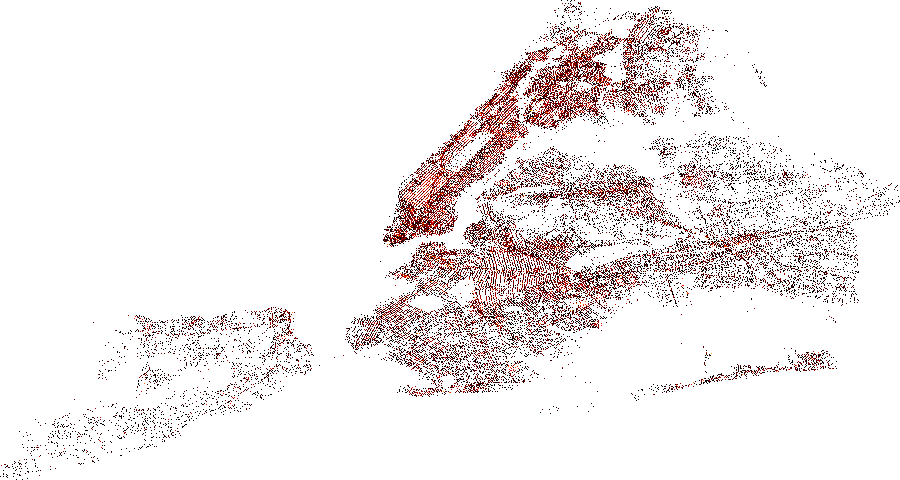

In [5]:
# From the provided datashader documentation, here's a way to use datashader without loading in a baselayer first. 
# This is the map of every single call placed in NYC. 
import datashader as ds, pandas as pd, colorcet
#df  = pd.read_csv('census.csv')
cvs = ds.Canvas(plot_width=900, plot_height=480)
agg = cvs.points(calls_df, 'longitude', 'latitude')
img = ds.tf.shade(agg, cmap=colorcet.fire, how='log')
img

### 5.2 Mapping Crimes in Progress Calls with Datashader

In [ ]:
# However, I want to see the map of calls for service placed where there is a call relating to a crime in progress. Therefore, I just need to use .loc to 
# subset the original calls_df to include only calls where cip_jobs == Critical and == Non Critical 

In [8]:
calls_df.head()

,typ_desc,cip_jobs,latitude,longitude
0,VEHICLE ACCIDENT: INJURY,Non CIP,40.649730,-73.936475
1,ALARMS: COMMERCIAL/BURGLARY,Non CIP,40.662817,-73.881221
2,ALARMS: RESIDENTIAL/BURGLARY,Non CIP,40.762587,-73.912199
3,ALARMS: RESIDENTIAL/BURGLARY,Non CIP,40.610729,-73.967644
4,ALARMS: COMMERCIAL/BURGLARY,Non CIP,40.748119,-73.891679


In [27]:
critical_calls_df = calls_df[calls_df['cip_jobs'] == 'Critical'] # Using loc to sort them by critical 
non_critical_calls_df = calls_df[calls_df['cip_jobs'] == 'Non Critical'] # and then also by non critical 

,typ_desc,cip_jobs,latitude,longitude
17,ASSIST POLICE OFFICER: UNIFORM/INSIDE,Critical,40.694715,-73.974390
18,ASSIST POLICE OFFICER: UNIFORM/INSIDE,Critical,40.694715,-73.974390
33,INVESTIGATE/POSSIBLE CRIME: SHOTS FIRED/OUTSIDE,Critical,40.676400,-73.958286
41,INVESTIGATE/POSSIBLE CRIME: SHOTS FIRED/OUTSIDE,Critical,40.643700,-73.941561
52,SHOT SPOTTER,Critical,40.677656,-73.881684


In [29]:
# using pd.concat to add them together. this is now all the calls that refer to a crime in progress. 
CIP_calls_df = pd.concat([critical_calls_df, non_critical_calls_df])
print(len(CIP_calls_df))

240529


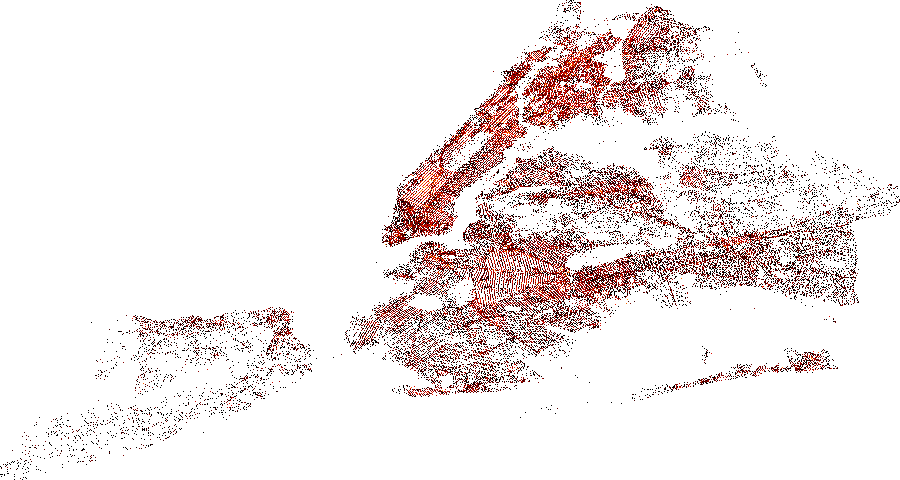

In [30]:
# Using datashader to plot the crimes in progress calls 
import datashader as ds, pandas as pd, colorcet
cvs = ds.Canvas(plot_width=900, plot_height=480)
agg = cvs.points(CIP_calls_df, 'longitude', 'latitude')
img = ds.tf.shade(agg, cmap=colorcet.fire, how='log')
img

### 5.3 Mapping the non crimes-in-progress calls with datashader


In [ ]:
# In order to compare the calls that refer to a crime in progress and the calls that don't, I need to define the non_CIP calls 
# Plotting the calls that do not refer to a crime in progress
non_CIP_calls_df = calls_df[calls_df['cip_jobs'] == 'Non CIP']

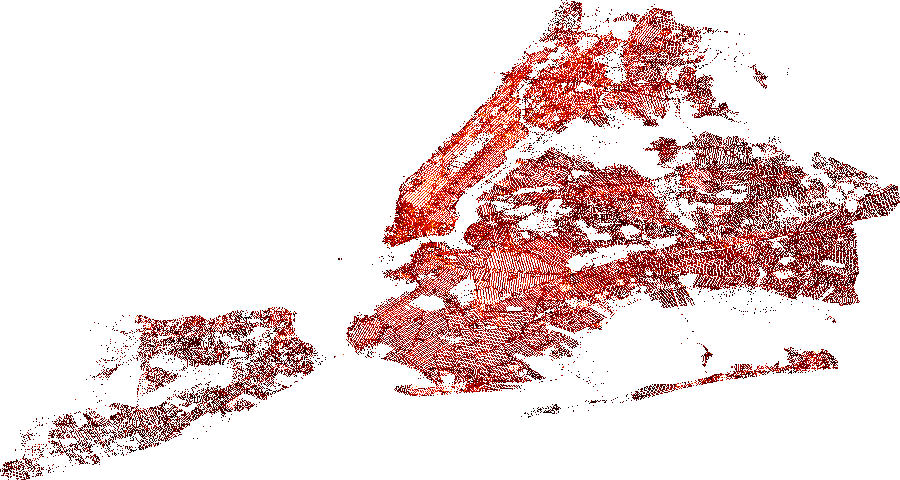

In [50]:
# Using datashader to plot the non crimes in progress calls 
import datashader as ds, pandas as pd, colorcet
cvs = ds.Canvas(plot_width=900, plot_height=480)
agg = cvs.points(non_CIP_calls_df, 'longitude', 'latitude')
img = ds.tf.shade(agg, cmap=colorcet.fire, how='log')
img

## 6. Using hvplot

In [ ]:
# Ensuring all the libraries are loaded. 
import holoviews as hv, pandas as pd, colorcet as cc
from holoviews.element.tiles import EsriImagery
from holoviews.operation.datashader import datashade
hv.extension('bokeh')

### 6.1 All calls with hvplot

In [49]:
map_tiles = EsriImagery().opts(alpha=0.5, width=900, height=480, bgcolor='black')
plot = calls_df.hvplot(
    'longitude',
    'latitude',
    kind='scatter',
    rasterize=True,
    cmap=cc.fire,
    cnorm='eq_hist'
).opts(title='All Calls in 2023') # This addition to add a title is from the hvplot documentation: https://hvplot.holoviz.org/user_guide/Geographic_Data.html 
map_tiles * plot

:DynamicMap   []
   :Overlay
      .Tiles.I :Tiles   [x,y]
      .Image.I :Image   [longitude,latitude]   (longitude_latitude Count)

### 6.2 Crime-in-progress Calls with hvplot 

In [48]:
map_tiles = EsriImagery().opts(alpha=0.5, width=900, height=480, bgcolor='black')
plot = CIP_calls_df.hvplot(
    'longitude',
    'latitude',
    kind='scatter',
    rasterize=True,
    cmap=cc.fire,
    cnorm='eq_hist'
).opts(title='CIP Calls in 2023') 
map_tiles * plot

:DynamicMap   []
   :Overlay
      .Tiles.I :Tiles   [x,y]
      .Image.I :Image   [longitude,latitude]   (longitude_latitude Count)

### 6.3 Non Crimes in Progress Calls 

In [45]:
map_tiles = EsriImagery().opts(alpha=0.5, width=900, height=480, bgcolor='black')
plot = non_CIP_calls_df.hvplot(
    'longitude',
    'latitude',
    kind='scatter',
    rasterize=True,
    cmap=cc.fire,
    cnorm='eq_hist'
).opts(title='Non CIP Calls in 2023') 
map_tiles * plot

:DynamicMap   []
   :Overlay
      .Tiles.I :Tiles   [x,y]
      .Image.I :Image   [longitude,latitude]   (longitude_latitude Count)

# Finishing the Lab

Please ensure that you save all your code and upload the latest version of this notebook to your **GitHub repository**. Add also a PDF file with the presentation related to the T9 of challenge 4.

> Always check the size of your notebook before making any commit; make good use of the `.gitignore` to skip big data sets or undesired files.


# More resources

* [Stats Methods](http://www.statmethods.net/stats/descriptives.html) - some useful descriptions of various descriptive statistic methods / packages
* [Pandas cheat sheet](https://www.geeksforgeeks.org/pandas-cheat-sheet/) - lots of useful help and functions for working with spatial data
* [Urban Analytics Book](https://uk.sagepub.com/en-gb/eur/urban-analytics/book249267) - One of the most valuable and inital resources